## Importações

In [2]:
# Instalando o mlxtend
!pip3 install mlxtend

     ---------------------------------------- 1.4/1.4 MB 7.7 MB/s eta 0:00:00


In [4]:
#Bibliotecas essenciais
import numpy as np
import pandas as pd
import datetime as  dt

# Bibliotecas de visualização
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from pandas.plotting import parallel_coordinates

# Bibliotecas de Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score,classification_report, confusion_matrix, roc_auc_score, plot_confusion_matrix, roc_curve
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from sqlalchemy import create_engine
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.feature_selection import VarianceThreshold
from dateutil.relativedelta import relativedelta
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

# 1-) Leitura dos dados

In [8]:
#path = '/content/drive/MyDrive/Curso Vai Academy/VAI Academy - pessoal/Kit Projeto Final/Dados'#"drive/MyDrive/Data_Science/VAI_Academy/Curso/Projeto_Final/1661365943_Kit Projeto Final_/Dados/"
path = "C:/Users/douglas.souza/OneDrive - GOLDEN GOAL SPORTS VENTURES GESTÃO ESPORTIVA LTDA/Documentos/d-pet-analysis/dados/"
sns.set_style("darkgrid")

In [21]:
# Tabela de clientes

clientes_df  = pd.read_csv(path+'cliente.csv', sep=',')
clientes_df.head()


,ID_CLIENTE,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA
0,0,,1900/01/01,2017/03/06
1,1,,1900/01/01,2017/03/06
2,2,,1900/01/01,2017/03/06
3,3,,1900/01/01,2017/02/18
4,4,,1900/01/01,2017/01/16


In [22]:
display(clientes_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105924 entries, 0 to 105923
Data columns (total 4 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   ID_CLIENTE       105924 non-null  int64 
 1   SEXO             105924 non-null  object
 2   DATA_NASCIMENTO  105924 non-null  object
 3   PRIMEIRA_COMPRA  105924 non-null  object
dtypes: int64(1), object(3)
memory usage: 3.2+ MB


None

In [27]:
# Leitura dos arquivos utilizados na construção do Dataset

produtos_df  = pd.read_csv(path+"/produto.csv")
produtos_df.head()


,ID_PRODUTO,UNIDADE,NIVEL 1,NIVEL 2,NIVEL 3,NIVEL 4
0,0,UN,CAES,ALIMENTOS,PETISCOS E OSSINHOS,BISCOITOS - BIFINHOS - SNACKS
1,1,UN,CAES,ALIMENTOS,PETISCOS E OSSINHOS,BISCOITOS - BIFINHOS - SNACKS
2,2,UN,CAES,ALIMENTOS,PETISCOS E OSSINHOS,BISCOITOS - BIFINHOS - SNACKS
3,3,UN,,,,
4,4,UN,CAES,FARMACIA,DORES E INFECCOES,ANTIBIOTICOS


In [28]:
produtos_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38308 entries, 0 to 38307
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   ID_PRODUTO  38308 non-null  int64 
 1   UNIDADE     38308 non-null  object
 2   NIVEL 1     38308 non-null  object
 3   NIVEL 2     38308 non-null  object
 4   NIVEL 3     38308 non-null  object
 5   NIVEL 4     38308 non-null  object
dtypes: int64(1), object(5)
memory usage: 1.8+ MB


In [12]:
# Tabela de vendas

vendas_df  = pd.read_csv(path+"/venda.csv",decimal='.',thousands=',')
display(vendas_df)

,ID_VENDA,DATA_VENDA,ID_CLIENTE,ID_PRODUTO,QUANTIDADE,CATEGORIA_VENDA,FILIAL
0,0,2021/02/10,45659.0,17631,1.0,E-COMMERCE,101
1,0,2021/02/10,45659.0,34575,1.0,E-COMMERCE,101
2,1,2021/02/12,70766.0,2240,1.0,E-COMMERCE,101
3,2,2021/02/12,42579.0,17707,1.0,E-COMMERCE,101
4,2,2021/02/12,42579.0,8952,1.0,E-COMMERCE,101
...,...,...,...,...,...,...,...
1859578,854530,2021/10/23,NaN,36642,10.0,Loja,113
1859579,854530,2021/10/23,NaN,7332,10.0,Loja,113
1859580,854530,2021/10/23,NaN,7333,10.0,Loja,113
1859581,854531,2021/10/23,106865.0,7528,1.0,Loja,113


In [13]:
display(vendas_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1859583 entries, 0 to 1859582
Data columns (total 7 columns):
 #   Column           Dtype  
---  ------           -----  
 0   ID_VENDA         int64  
 1   DATA_VENDA       object 
 2   ID_CLIENTE       float64
 3   ID_PRODUTO       int64  
 4   QUANTIDADE       float64
 5   CATEGORIA_VENDA  object 
 6   FILIAL           int64  
dtypes: float64(2), int64(3), object(2)
memory usage: 99.3+ MB


None

In [30]:
display(vendas_df.describe())

,ID_VENDA,ID_CLIENTE,ID_PRODUTO,QUANTIDADE,FILIAL
count,1.859583e+06,929717.00000,1.859583e+06,1.859583e+06,1.859583e+06
mean,4.337302e+05,48943.58105,1.748156e+04,9.801635e+00,1.033833e+02
std,2.405925e+05,26031.33408,1.175073e+04,9.233485e+01,2.222510e+00
min,0.000000e+00,7.00000,0.000000e+00,0.000000e+00,1.010000e+02
25%,2.269360e+05,29686.00000,7.761000e+03,1.000000e+00,1.020000e+02
50%,4.335990e+05,48219.00000,1.537900e+04,1.000000e+00,1.030000e+02
75%,6.409040e+05,67863.00000,2.660900e+04,1.000000e+00,1.050000e+02
max,8.545320e+05,106865.00000,3.836200e+04,2.472220e+04,1.130000e+02


# 2-) Análise Exploratória de Dados

In [31]:
# Ajusta a coluna de data

clientes_df['DATA_NASCIMENTO'] = pd.to_datetime(clientes_df['DATA_NASCIMENTO'],errors='ignore')
clientes_df['PRIMEIRA_COMPRA'] = pd.to_datetime(clientes_df['PRIMEIRA_COMPRA'],errors='ignore')

vendas_df['DATA_VENDA'] = pd.to_datetime(vendas_df['DATA_VENDA'],errors='ignore')

In [32]:
# Troca de string vazia por NaN

clientes_df.replace(r'^\s*$', np.nan, regex=True,inplace=True)
produtos_df.replace(r'^\s*$', np.nan, regex=True,inplace=True)
vendas_df.replace(r'^\s*$', np.nan, regex=True,inplace=True)

display(clientes_df.info())
display(produtos_df.info())
display(vendas_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105924 entries, 0 to 105923
Data columns (total 4 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   ID_CLIENTE       105924 non-null  int64         
 1   SEXO             46523 non-null   object        
 2   DATA_NASCIMENTO  105924 non-null  object        
 3   PRIMEIRA_COMPRA  105924 non-null  datetime64[ns]
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 3.2+ MB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38308 entries, 0 to 38307
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   ID_PRODUTO  38308 non-null  int64 
 1   UNIDADE     38308 non-null  object
 2   NIVEL 1     25739 non-null  object
 3   NIVEL 2     25739 non-null  object
 4   NIVEL 3     25109 non-null  object
 5   NIVEL 4     21402 non-null  object
dtypes: int64(1), object(5)
memory usage: 1.8+ MB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1859583 entries, 0 to 1859582
Data columns (total 7 columns):
 #   Column           Dtype         
---  ------           -----         
 0   ID_VENDA         int64         
 1   DATA_VENDA       datetime64[ns]
 2   ID_CLIENTE       float64       
 3   ID_PRODUTO       int64         
 4   QUANTIDADE       float64       
 5   CATEGORIA_VENDA  object        
 6   FILIAL           int64         
dtypes: datetime64[ns](1), float64(2), int64(3), object(1)
memory usage: 99.3+ MB


None

tratativa de dados para converter valores e tratar faltantes

## 2.1-) Produtos

In [33]:
# Retirar espaço vazio nas strings dos niveis

produtos_df["NIVEL 1"] = produtos_df["NIVEL 1"].str.strip()
produtos_df["NIVEL 2"] = produtos_df["NIVEL 2"].str.strip()
produtos_df["NIVEL 3"] = produtos_df["NIVEL 3"].str.strip()
produtos_df["NIVEL 4"] = produtos_df["NIVEL 4"].str.strip()

In [34]:
# Contagem de vendas por Nivel 1 de produto
fig = px.histogram(produtos_df, x='NIVEL 1', text_auto = True, color_discrete_sequence=px.colors.qualitative.D3)
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [35]:
# Contagem de vendas por Nivel 2 de produto
produtos_df['NIVEL 1+2'] = produtos_df['NIVEL 1'] + ' - ' + produtos_df['NIVEL 2']
fig = px.histogram(produtos_df, x='NIVEL 1+2', text_auto = True, color_discrete_sequence=px.colors.qualitative.D3)
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [36]:
# Distribuição percentual de cada nivel 2 nos niveis 1
n1_n2 = (produtos_df.groupby("NIVEL 1")['NIVEL 2'].value_counts()/produtos_df.groupby("NIVEL 1")['NIVEL 2'].count()).reset_index(0)

n1_n2['value'] = n1_n2['NIVEL 2']
n1_n2.drop(columns = ["NIVEL 2"], inplace=True)
n1_n2.reset_index(inplace=True)
n1_n2['value'] = n1_n2.value.round(3)

fig = px.bar(n1_n2, x = 'NIVEL 1', y = 'value', color='NIVEL 2',labels={"value":"Porcentagem"},template="seaborn")
fig.update_layout(title={'text':'Porcentagem de produtos do Nivel 2 em cada Nivel 1','x':0.25})
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [37]:
# Quantidade dos subniveis nos "niveis mães"

n2_n3 = produtos_df.groupby("NIVEL 2")['NIVEL 3'].nunique().to_frame().reset_index()
n2_n3.rename(columns={'NIVEL 3':'Quantidade'},inplace=True)

n3_n4 = produtos_df.groupby("NIVEL 3")['NIVEL 4'].nunique().to_frame().reset_index()
n3_n4.rename(columns={'NIVEL 4':'Quantidade'},inplace=True)

fig = make_subplots(
    rows=2, cols=1,
    subplot_titles=("Quantidade de tipos de produtos distintos do Nivel 3 em cada Nivel 2",'Quantidade de tipos de produtos distintos do Nivel 4 em cada Nivel 3'))

fig.add_trace(go.Bar(x=n2_n3['NIVEL 2'],y=n2_n3['Quantidade']),row=1, col=1)
fig.add_trace(go.Bar(x=n3_n4['NIVEL 3'],y=n3_n4['Quantidade']),row=2, col=1)

fig.update_layout(
    width=1200,
    height=800,showlegend=False)

fig.show()


c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



## 2.2-) Clientes

In [38]:
# Retirada de dados inconsistentes nas datas

clientes_df.loc[clientes_df[clientes_df.PRIMEIRA_COMPRA < '1950-01-01 00:00:00'].index,"PRIMEIRA_COMPRA"] = np.nan
clientes_df.loc[clientes_df[((clientes_df.DATA_NASCIMENTO < '1950-01-01 00:00:00') |
                             (clientes_df.DATA_NASCIMENTO > '2003-01-01 00:00:00'))].index,"DATA_NASCIMENTO"] = np.nan

clientes_df["DATA_NASCIMENTO"] = pd.to_datetime(clientes_df.DATA_NASCIMENTO)

clientes_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105924 entries, 0 to 105923
Data columns (total 4 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   ID_CLIENTE       105924 non-null  int64         
 1   SEXO             46523 non-null   object        
 2   DATA_NASCIMENTO  43723 non-null   datetime64[ns]
 3   PRIMEIRA_COMPRA  101864 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(1), object(1)
memory usage: 3.2+ MB


C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\2737833969.py:20: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



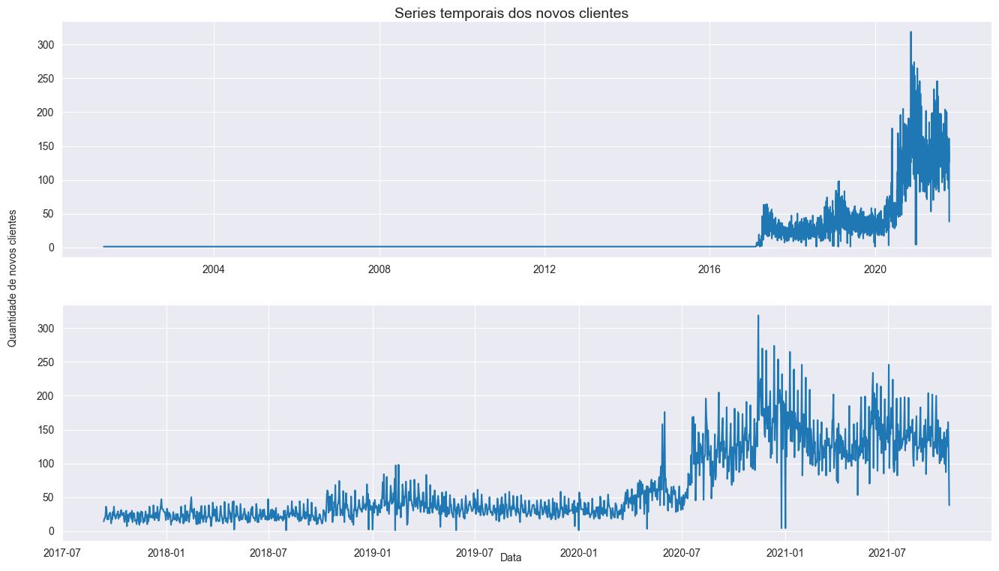

In [39]:
# Serie temporal para primeiras compras

primeira_compra = clientes_df.groupby("PRIMEIRA_COMPRA")["ID_CLIENTE"].count().reset_index()
primeira_compra.rename(columns={"ID_CLIENTE":"count"},inplace=True)

fig,ax = plt.subplots(2,1,figsize=(16,9))
sns.lineplot(x=primeira_compra["PRIMEIRA_COMPRA"],y=primeira_compra["count"],ax=ax[0])
ax[0].set_xlabel("")
ax[0].set_ylabel("")
primeira_compra = primeira_compra.loc["2017-01-01 00:00:00":,:]
sns.lineplot(x=primeira_compra["PRIMEIRA_COMPRA"],y=primeira_compra["count"],ax=ax[1])
ax[1].set_xlabel("")
ax[1].set_ylabel("")


fig.suptitle("Series temporais dos novos clientes",y=0.9, fontsize=14)
fig.text(0.5, 0.08, 'Data', ha='center',fontsize=10)
fig.text(0.08, 0.5, 'Quantidade de novos clientes', va='center', rotation='vertical',fontsize=10)

fig.show()

Insights:
*   Até 2017 a quantidade de novos clientes era muito baixa.
*   A partir de 2020 ocorre uma alta quantidade de novos clientes.







In [40]:
# Limpeza dos dados a partir da primeira compra
print(clientes_df.shape)
clientes_df = clientes_df[(clientes_df['PRIMEIRA_COMPRA'] > '2020-01-01') & (clientes_df['PRIMEIRA_COMPRA'] < '2021-07-26') ]
print(clientes_df.shape)

(105924, 4)
(60578, 4)


In [ ]:
# Primeiramente é necessário unificar F e M (não deixar m e f)
clientes_df['SEXO'] = clientes_df['SEXO'].map({'m':'M','f':'F','F':'F', 'M':'M', 'O':'O'})


In [42]:
# visualizando as categorias de sexo
fig = px.histogram(clientes_df, x='SEXO', text_auto = True,  color_discrete_sequence=px.colors.qualitative.D3)
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [ ]:
# Distribuição das idades
# Cálculo da idade
#Inserção da idade de cada cliente

idade = ((dt.datetime.strptime("2022-09-17","%Y-%m-%d") - pd.to_datetime(clientes_df.DATA_NASCIMENTO[clientes_df.DATA_NASCIMENTO.isnull()==False]))/365.2425).dt.days
idade.rename("idade",inplace=True)

clientes_df.loc[clientes_df.DATA_NASCIMENTO.isnull().index,"idade"] = idade



In [44]:
# Distribuição das idades

fig = px.histogram(clientes_df, x='idade', title = 'Distruibuição de Idades por Faixa Etária', text_auto = True, nbins = 20, color_discrete_sequence=px.colors.qualitative.D3)
fig.update_layout(bargap = 0.05)
fig.update_xaxes(range=[0, 100])
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



## 2.3-) Vendas

In [45]:
# Retirar espaços vazios nas strings de categoria

vendas_df['CATEGORIA_VENDA'] = vendas_df.CATEGORIA_VENDA.str.strip()

In [46]:
# Transformação de tipos de dados

vendas_df["QUANTIDADE"] = vendas_df["QUANTIDADE"].astype(float)
vendas_df["ID_CLIENTE"] = vendas_df["ID_CLIENTE"].astype(int,errors='ignore')


In [47]:
# Quantidade de vendas por categoria de venda

categoria = vendas_df.groupby("CATEGORIA_VENDA").ID_VENDA.nunique()

fig = px.bar(categoria,labels={"CATEGORIA_VENDA":"Categoria","value":"Quantidade de vendas"}, color_discrete_sequence=px.colors.qualitative.D3)
fig.update_layout(showlegend=False)
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [48]:
# Quantidade de vendas por filial

filial = vendas_df.groupby("FILIAL").ID_VENDA.nunique()
filiais_name = filial.index
fig = px.bar(x = filial.index, y= filial.values,labels={"x":"Filial","y":"Quantidade de vendas"}, color_discrete_sequence=px.colors.qualitative.D3, text_auto=True)
fig.update_layout(showlegend=False,
    plot_bgcolor = 'rgba(255, 255, 255, 255)',
    paper_bgcolor = 'rgba(255, 255, 255, 255)')

fig.update_xaxes(linecolor = 'black')
fig.update_yaxes(linecolor = 'black')

fig.update_xaxes(type='category')

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\1388762431.py:21: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



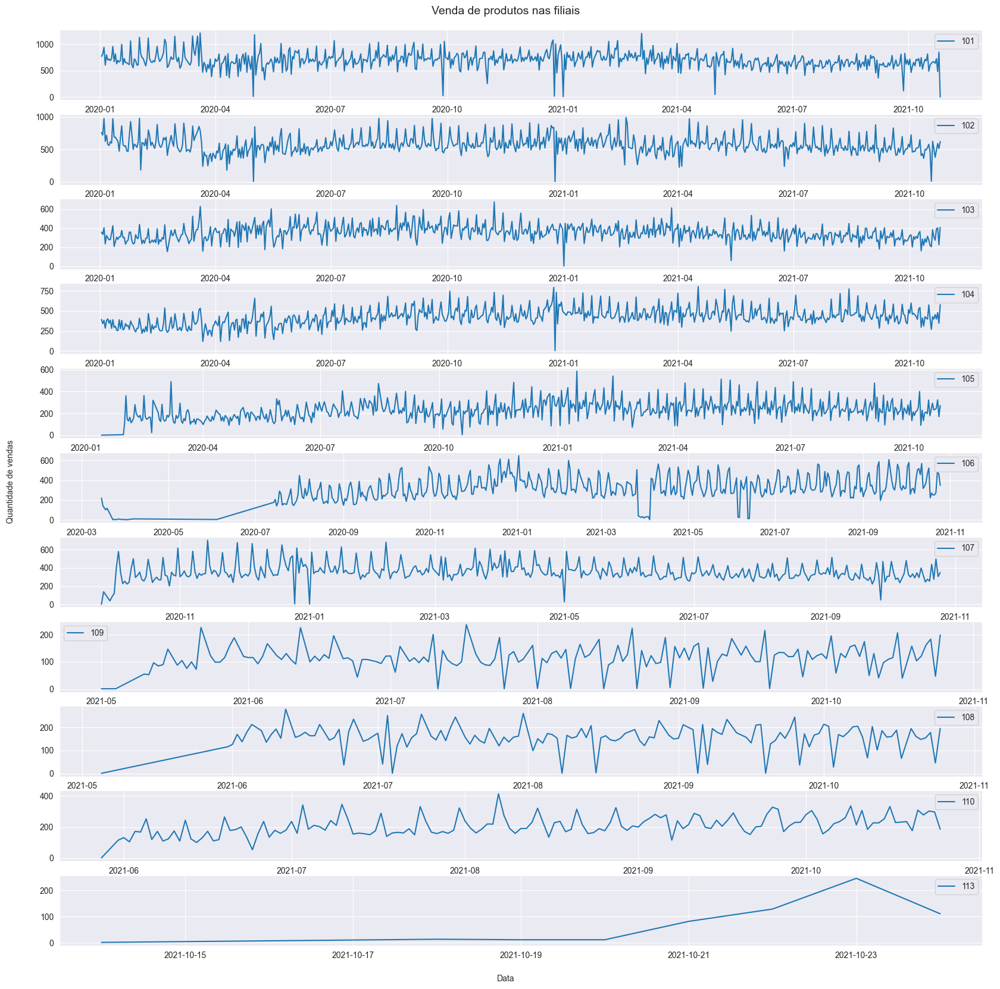

In [49]:
# Serie temporal da venda nas filiais

ts_filiais = vendas_df.groupby(["DATA_VENDA","FILIAL"]).ID_VENDA.count().reset_index()
ts_filiais.rename(columns={"ID_VENDA":"count_vendas"})

categorias_filiais = ts_filiais.FILIAL.unique()

fig,ax = plt.subplots(len(categorias_filiais),1,figsize=(20,20))

for i in range(len(categorias_filiais)):
  ts_cat = ts_filiais[ts_filiais.FILIAL==categorias_filiais[i]]
  sns.lineplot(x = ts_cat.DATA_VENDA,y = ts_cat.ID_VENDA,ax=ax[i])

  ax[i].legend([categorias_filiais[i]])
  ax[i].set_xlabel("")
  ax[i].set_ylabel("")

fig.suptitle("Venda de produtos nas filiais",y=0.9, fontsize=14)
fig.text(0.5, 0.08, 'Data', ha='center',fontsize=10)
fig.text(0.08, 0.5, 'Quantidade de vendas', va='center', rotation='vertical',fontsize=10)
fig.show()

In [50]:
# visualizando a quantidade de vendas por dia
fig = px.scatter(vendas_df[['ID_VENDA', 'DATA_VENDA']].groupby('DATA_VENDA').count().reset_index(), y='ID_VENDA', x = 'DATA_VENDA', color_discrete_sequence=px.colors.qualitative.D3)
fig.update_yaxes(title = 'QTDE_VENDA_POR_DIA')
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\1761649922.py:21: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



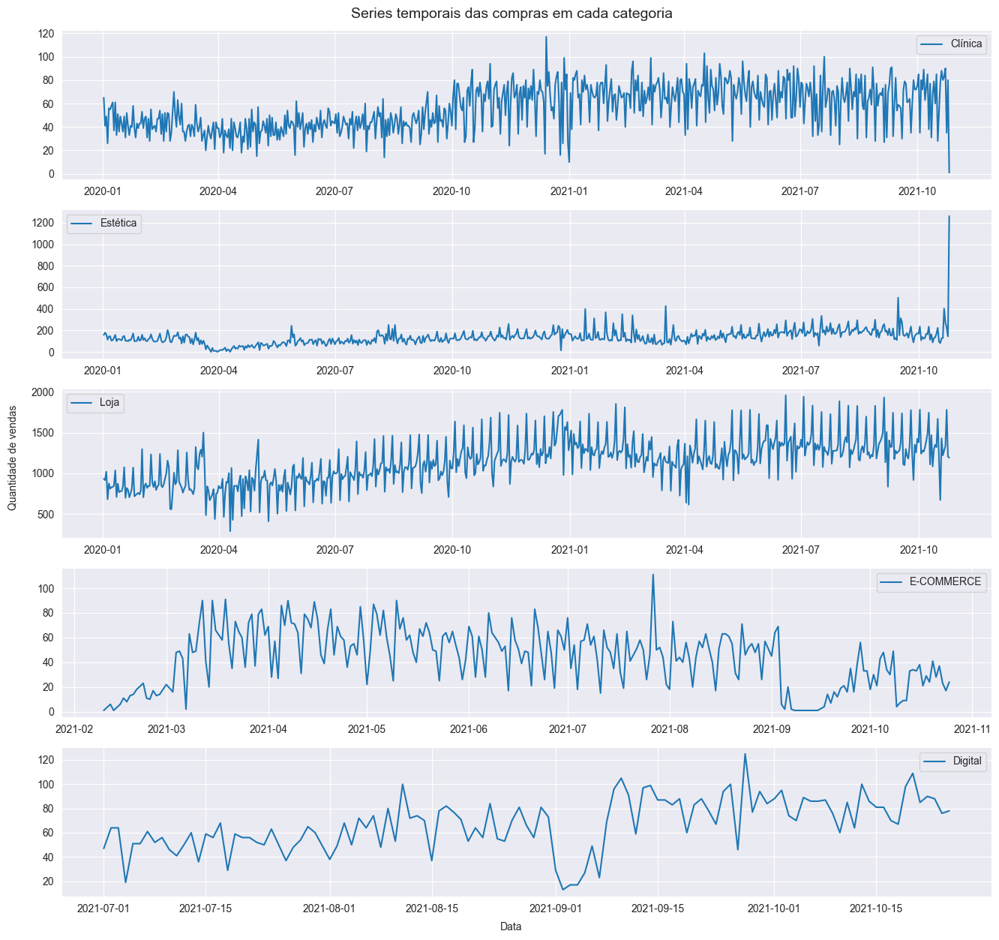

In [51]:
# Series temporais das vendas, divididos por categoria

ts_categoria = vendas_df.groupby(["DATA_VENDA","CATEGORIA_VENDA"]).ID_VENDA.nunique().reset_index()
ts_categoria.rename(columns={"ID_VENDA":"count_vendas"})

categorias_names = ts_categoria.CATEGORIA_VENDA.unique()

fig,ax = plt.subplots(len(categorias_names),1,figsize=(16,15))

for i in range(len(categorias_names)):
  ts_cat = ts_categoria[ts_categoria.CATEGORIA_VENDA==categorias_names[i]]
  sns.lineplot(x = ts_cat.DATA_VENDA,y = ts_cat.ID_VENDA,ax=ax[i])

  ax[i].legend([categorias_names[i]])
  ax[i].set_xlabel("")
  ax[i].set_ylabel("")

fig.suptitle("Series temporais das compras em cada categoria",y=0.9, fontsize=14)
fig.text(0.5, 0.08, 'Data', ha='center',fontsize=10)
fig.text(0.08, 0.5, 'Quantidade de vendas', va='center', rotation='vertical',fontsize=10)
fig.show()

In [52]:
# Distribuição da quantidade de compras por cliente

QTD_VENDAS = vendas_df.groupby("ID_CLIENTE").ID_VENDA.nunique()

fig = px.box(QTD_VENDAS, color_discrete_sequence=px.colors.qualitative.D3)
fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insights:

*   75% dos clientes tem menos de 6 compras
*   25% compraram apenas uma vez
*   Alguns outliers parecem ser dados incosistentes, como 998 compras





In [53]:
# Distribuição da quantidade de cada produto em cada venda por categoria

fig = make_subplots(rows=len(categorias_names), cols=1,subplot_titles=categorias_names)

for i in range(len(categorias_names)):
  dist_cat = vendas_df[vendas_df.CATEGORIA_VENDA==categorias_names[i]].QUANTIDADE
  fig.add_trace(go.Histogram(x = dist_cat.values),row=(i+1),col=1)

fig.update_layout(
    width=900,
    height=900,
    showlegend=False)

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insights:
*   No setor varejista (Loja fisica, Digital e e-commerce) a quase totalidade dos produtos é comprado uma unica unidade.
*   No setor de serviço (Estetica e Clinica) a quantidade é o valor do serviço



In [54]:
# Distribuição da quantidade de produtos/serviços em cada venda por categoria

qtd_vendas = vendas_df.groupby(["CATEGORIA_VENDA","ID_VENDA"]).ID_PRODUTO.count().reset_index()

fig = make_subplots(rows=len(categorias_names), cols=1,subplot_titles=categorias_names)

for i in range(len(categorias_names)):
  dist_cat = qtd_vendas[qtd_vendas.CATEGORIA_VENDA==categorias_names[i]].ID_PRODUTO
  fig.add_trace(go.Box(x = dist_cat.values),row=(i+1),col=1)

fig.update_layout(
    width=900,
    height=900,
    showlegend=False)

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insights:
*   Nas clinicas as vendas são de apenas 1 serviço, com raras exceções. Ocorre algo semelhante no setor de estetica.
*   O setor varejista ocorre vendas com varios produtos, principalmente no E-COMMERCE.



## 2.4-) Cliente-Venda-Produto

In [55]:
# Unificação dos datasets
cliente_venda_df = vendas_df.merge(right=clientes_df,how='left',on="ID_CLIENTE")
cliente_venda_produto_df = cliente_venda_df.merge(right=produtos_df,how='left',on="ID_PRODUTO")
cliente_venda_produto_df

,ID_VENDA,DATA_VENDA,ID_CLIENTE,ID_PRODUTO,QUANTIDADE,CATEGORIA_VENDA,FILIAL,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,UNIDADE,NIVEL 1,NIVEL 2,NIVEL 3,NIVEL 4,NIVEL 1+2
0,0,2021-02-10,45659.0,17631,1.0,E-COMMERCE,101,M,1985-07-31,2020-09-08,37.0,UN,CAES,ALIMENTOS,PETISCOS E OSSINHOS,BISCOITOS - BIFINHOS - SNACKS,CAES - ALIMENTOS
1,0,2021-02-10,45659.0,34575,1.0,E-COMMERCE,101,M,1985-07-31,2020-09-08,37.0,UN,CAES,ALIMENTOS,PETISCOS E OSSINHOS,BISCOITOS - BIFINHOS - SNACKS,CAES - ALIMENTOS
2,1,2021-02-12,70766.0,2240,1.0,E-COMMERCE,101,NaN,NaT,2021-02-12,NaN,UN,CAES,ACESSORIOS,CAMINHAS E CASINHAS,ALMOFADAS E COLCHONETES,CAES - ACESSORIOS
3,2,2021-02-12,42579.0,17707,1.0,E-COMMERCE,101,NaN,NaT,2020-08-13,NaN,UN,CAES,FARMACIA,VITAMINAS E SUPLEMENTOS,VITAMINAS E SUPLEMENTOS,CAES - FARMACIA
4,2,2021-02-12,42579.0,8952,1.0,E-COMMERCE,101,NaN,NaT,2020-08-13,NaN,UN,CAES,FARMACIA,DEMAIS MEDICAMENTOS,TRATAMENTO DIGESTIVO,CAES - FARMACIA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1859578,854530,2021-10-23,NaN,36642,10.0,Loja,113,NaN,NaT,NaT,NaN,UN,GATOS,ALIMENTOS,RACOES,RACAO UMIDA (SACHES E LATAS),GATOS - ALIMENTOS
1859579,854530,2021-10-23,NaN,7332,10.0,Loja,113,NaN,NaT,NaT,NaN,UN,GATOS,ALIMENTOS,RACOES,RACAO UMIDA (SACHES E LATAS),GATOS - ALIMENTOS
1859580,854530,2021-10-23,NaN,7333,10.0,Loja,113,NaN,NaT,NaT,NaN,UN,GATOS,ALIMENTOS,RACOES,RACAO UMIDA (SACHES E LATAS),GATOS - ALIMENTOS
1859581,854531,2021-10-23,106865.0,7528,1.0,Loja,113,NaN,NaT,NaT,NaN,UN,CAES,ALIMENTOS,PETISCOS E OSSINHOS,OSSINHOS E PALITOS,CAES - ALIMENTOS


In [56]:
cliente_venda_produto_df.describe(include='all')

C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\2858795815.py:1: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.

C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\2858795815.py:1: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.

C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\2858795815.py:1: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



,ID_VENDA,DATA_VENDA,ID_CLIENTE,ID_PRODUTO,QUANTIDADE,CATEGORIA_VENDA,FILIAL,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,UNIDADE,NIVEL 1,NIVEL 2,NIVEL 3,NIVEL 4,NIVEL 1+2
count,1.859583e+06,1859583,929717.00000,1.859583e+06,1.859583e+06,1859583,1.859583e+06,429866,399476,648414,399476.000000,1731080,1729180,1729180,1714140,1541939,1729180
unique,NaN,663,NaN,NaN,NaN,5,NaN,3,14120,570,NaN,12,6,7,32,61,26
top,NaN,2021-07-03 00:00:00,NaN,NaN,NaN,Loja,NaN,F,2000-07-21 00:00:00,2020-11-14 00:00:00,NaN,UN,CAES,ALIMENTOS,RACOES,RACAO SECA,CAES - ALIMENTOS
freq,NaN,4965,NaN,NaN,NaN,1698909,NaN,262497,460,4505,NaN,1692983,1227868,874906,611452,334576,569356
first,NaN,2020-01-02 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,1950-01-03 00:00:00,2020-01-02 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2021-10-26 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,2002-12-26 00:00:00,2021-07-25 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,4.337302e+05,NaN,48943.58105,1.748156e+04,9.801635e+00,NaN,1.033833e+02,NaN,NaN,NaN,41.351293,NaN,NaN,NaN,NaN,NaN,NaN
std,2.405925e+05,NaN,26031.33408,1.175073e+04,9.233485e+01,NaN,2.222510e+00,NaN,NaN,NaN,11.403132,NaN,NaN,NaN,NaN,NaN,NaN
min,0.000000e+00,NaN,7.00000,0.000000e+00,0.000000e+00,NaN,1.010000e+02,NaN,NaN,NaN,19.000000,NaN,NaN,NaN,NaN,NaN,NaN
25%,2.269360e+05,NaN,29686.00000,7.761000e+03,1.000000e+00,NaN,1.020000e+02,NaN,NaN,NaN,33.000000,NaN,NaN,NaN,NaN,NaN,NaN


### Análise da evolução percentual do churn ao longo dos meses

In [57]:
# Criando os meses de referencia e pegando a ultima compra de cada cliente
meses_ref = pd.date_range(start = "2020-03-31 00:00:00",end = "2021-10-31 00:00:00",freq="M")

ultima_compra_clientes = pd.to_datetime(cliente_venda_produto_df.groupby("ID_CLIENTE").DATA_VENDA.max()).to_frame().reset_index()

In [58]:
# Definindo o mes que o cliente virou churn
def atividade_cliente(ultima_compra,meses_ref):
  try:
    time_mask = (meses_ref - ultima_compra - dt.timedelta(days=90))
    timedelta_min = time_mask[time_mask>dt.timedelta(days=0)].min()
    ano_mes = ( timedelta_min + ultima_compra+dt.timedelta(days=90)).strftime("%Y/%m")
    return ano_mes
  except:
    return "Cliente ativo"

ultima_compra_clientes['mes_churn'] = ultima_compra_clientes.DATA_VENDA.apply(lambda ultima_compra: atividade_cliente(ultima_compra,meses_ref))


In [59]:
# Para cada mes de referencia calculando a quantidade total de clientes(churn e ativos)
dataframe = cliente_venda_produto_df.sort_values("DATA_VENDA").reset_index().drop(columns="index").set_index("DATA_VENDA").copy()
meses_df = pd.DataFrame({"Mes_Referencia":meses_ref[1:],"Qtd_clientes":np.zeros(shape=(len(meses_ref[1:]),))})
qtd_clientes = []
for data in meses_ref[1:]:
  qtd_clientes.append(dataframe.loc[:data.strftime("%Y-%m-%d"),:].ID_CLIENTE.nunique())
meses_df["Qtd_clientes"] = np.array(qtd_clientes)
meses_df

,Mes_Referencia,Qtd_clientes
0,2020-04-30,9739
1,2020-05-31,12412
2,2020-06-30,14425
3,2020-07-31,18098
4,2020-08-31,22984
5,2020-09-30,27644
6,2020-10-31,32614
7,2020-11-30,38384
8,2020-12-31,44487
9,2021-01-31,49952


In [60]:
# Registrando o setor na qual a ultima compra de cada cliente foi feita

venda_client_group = cliente_venda_produto_df.groupby(["ID_CLIENTE","ID_VENDA"]).agg({"CATEGORIA_VENDA":pd.Series.mode,"DATA_VENDA":"max"}).reset_index()
venda_client_group



,ID_CLIENTE,ID_VENDA,CATEGORIA_VENDA,DATA_VENDA
0,7.0,11997,Estética,2020-06-15
1,7.0,285508,Clínica,2020-12-11
2,7.0,317729,Loja,2020-11-26
3,7.0,336134,Loja,2021-05-08
4,11.0,327271,Loja,2021-02-10
...,...,...,...,...
477003,106861.0,854523,Loja,2021-10-23
477004,106862.0,854524,Loja,2021-10-24
477005,106863.0,854525,Loja,2021-10-23
477006,106864.0,854528,Loja,2021-10-24


In [61]:
# Evolução do churn absoluto

churn = ultima_compra_clientes.groupby("mes_churn").count().reset_index()

fig = px.bar(x = churn.mes_churn.loc[churn.mes_churn != 'Cliente ativo'],
             y = churn.DATA_VENDA.loc[churn.mes_churn != 'Cliente ativo'],
             labels={"x": "Mês", "y":"Quantidade de clientes"},
             title =  "Quantidade de novos churns para cada mês",
             color_discrete_sequence=px.colors.qualitative.D3,
             text_auto=True)

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [62]:
# Evolução do churn percentual
churn = ultima_compra_clientes.groupby("mes_churn").count()
churn_percent = churn.drop(churn.tail(1).index)["DATA_VENDA"].values/meses_df["Qtd_clientes"].values
fig  = px.bar(x = churn.index[:-1],
              y = 100*churn_percent.round(3),
              labels={"x": "Mês", "y":"Porcentagem de clientes"},
              title="Porcentagem de novos churns, para cada mês, em relação ao total de clientes",
              color_discrete_sequence=px.colors.qualitative.D3,
              text_auto=True)

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [63]:
# Evolução do churn absoluto

fig.data = []
fig.layout = {}

fig = make_subplots(specs=[[{"secondary_y": True}]])

churn = ultima_compra_clientes.groupby("mes_churn").count().reset_index()
churn_percent = churn.drop(churn.tail(1).index)["DATA_VENDA"].values/meses_df["Qtd_clientes"].values

fig.add_trace(go.Bar(x = churn.mes_churn.loc[churn.mes_churn != 'Cliente ativo'],
             y = churn.DATA_VENDA.loc[churn.mes_churn != 'Cliente ativo'],
             name = 'nº Churn', marker=dict(color = 'steelblue')),
             secondary_y = False)

fig.add_trace(go.Scatter(x = churn.mes_churn[:-1],
              y = 100*churn_percent.round(3),
              name = '% Churn', marker=dict(color = 'darkseagreen')),
              secondary_y = True)

fig.update_layout(
    title = {"text":"Evolução em número absoluto e em percentual do churn na VAI Pet"},
    width=1200,
    height=400,
    showlegend=True,
    plot_bgcolor = 'rgba(255, 255, 255, 255)',
    paper_bgcolor = 'rgba(255, 255, 255, 255)')

fig.update_xaxes(linecolor = 'black')
fig.update_yaxes(linecolor = 'black')

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insight: A quantidade de clientes churnados vem aumentando.



In [64]:
# Evolução da quantidade de churn segmentado por categoria

df = ultima_compra_clientes.merge(right=venda_client_group,how="left",on=["ID_CLIENTE","DATA_VENDA"]).drop_duplicates(subset="ID_CLIENTE",keep='last')

fig = make_subplots(rows=len(categorias_names), cols=1,subplot_titles=categorias_names)

for i in range(len(categorias_names)):
  churn_cat = df[df.CATEGORIA_VENDA==categorias_names[i]].groupby("mes_churn").count()
  fig.add_trace(go.Bar(x = churn_cat.index, y = churn_cat.DATA_VENDA),row=(i+1),col=1)


fig.update_layout(
    title = {"text":"Evolução do churn em cada segmento de mercado"},
    width=1200,
    height=1200,
    showlegend=False)

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insights:
*   Constância na quantidade de novos churns no e-commer ao longo dos meses, no entanto, exitem mais clientes churnados do que clientes ativos em out/2021.
*   O segmento digital apresenta poucos dados para evolução do churn, porém tem uma boa relação da porcentagem de churn/clientes ativos.
*   Loja fisica, clinica de saude e estetica apresentam alta no churn nos meses finais de 2021.






In [65]:
# Evolução da quantidade de churn segmentado por categoria

fig.data = []
fig.layout = {}
fig  = go.Figure()

ultima_compra_clientes1 = ultima_compra_clientes
df1 = df
categorias_names1 = categorias_names

for i in range(len(categorias_names1)):
  churn_cat1 = df1[(df1.CATEGORIA_VENDA==categorias_names1[i]) & (df1.mes_churn != 'Cliente ativo')].groupby("mes_churn").count()
  fig.add_trace(go.Scatter(x = churn_cat1.index, y = churn_cat1.DATA_VENDA, mode= 'lines+markers', name=categorias_names1[i]))


fig.update_layout(
    title = {"text":"Evolução em número absoluto do churn em cada segmento de mercado"},
    width=1200,
    height=400,
    showlegend=True,
    plot_bgcolor = 'rgba(255, 255, 255, 255)',
    paper_bgcolor = 'rgba(255, 255, 255, 255)')

fig.update_xaxes(linecolor = 'black')
fig.update_yaxes(linecolor = 'black')

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [66]:
# Evolução percentual de churn segmentado por categoria

fig.data = []
fig.layout = {}
fig  = go.Figure()

ultima_compra_clientes1 = ultima_compra_clientes
df1 = df
categorias_names1 = categorias_names

for i in range(len(categorias_names1)):
  dataframe = cliente_venda_produto_df.loc[cliente_venda_produto_df['CATEGORIA_VENDA'] == categorias_names1[i]].sort_values("DATA_VENDA").reset_index().drop(columns="index").set_index("DATA_VENDA").copy()
  meses_df1 = pd.DataFrame({"Mes_Referencia":meses_ref[1:],"Qtd_clientes":np.zeros(shape=(len(meses_ref[1:]),))})
  qtd_clientes = []
  for data in meses_ref[1:]:
    qtd_clientes.append(dataframe.loc[:data.strftime("%Y-%m-%d"),:].ID_CLIENTE.nunique())
  meses_df1["Qtd_clientes"] = np.array(qtd_clientes)
  churn_cat1 = df1[(df1.CATEGORIA_VENDA==categorias_names1[i]) & (df1.mes_churn != 'Cliente ativo')].groupby("mes_churn").count()
  n = meses_df1.shape[0] - churn_cat1.shape[0]
  fig.add_trace(go.Scatter(x = churn_cat1.index, y = churn_cat1['DATA_VENDA'].values/meses_df1['Qtd_clientes'].iloc[n:].values, mode= 'lines+markers', name=categorias_names1[i]))


fig.update_layout(
    title = {"text":"Evolução percentual do churn em cada segmento de mercado"},
    width=1200,
    height=400,
    showlegend=True,
    plot_bgcolor = 'rgba(255, 255, 255, 255)',
    paper_bgcolor = 'rgba(255, 255, 255, 255)')

fig.update_xaxes(linecolor = 'black')
fig.update_yaxes(linecolor = 'black')

fig.show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [67]:
# Distribuição dos clintes churnados

specs = [[{"type": "bar"}, {"type": "pie"}] for i in range(len(categorias_names)+1)]
fig = make_subplots(rows = len(categorias_names)+1,cols=2,specs=specs)

geral_churn = df[df.mes_churn != "Cliente ativo"].ID_CLIENTE.nunique()
geral_n_churn = df[df.mes_churn == "Cliente ativo"].ID_CLIENTE.nunique()

fig.add_trace(go.Bar(x = ['Não Churn','Churn'], y = [geral_n_churn, geral_churn],legendgroup=1,name="Geral"),row = 1, col=1)
fig.add_trace(go.Pie(labels = ['Não Churn','Churn'], values = list(np.array([geral_n_churn, geral_churn])/df.ID_CLIENTE.nunique()),
                     showlegend=False,hovertemplate = "%{label}: %{percent} </br>",),row = 1, col=2)

for i in range(len(categorias_names)):
  churn_cat_churn = df[df.CATEGORIA_VENDA==categorias_names[i]][df.mes_churn != "Cliente ativo"].ID_CLIENTE.nunique()
  churn_cat_n_churn = df[df.CATEGORIA_VENDA==categorias_names[i]][df.mes_churn == "Cliente ativo"].ID_CLIENTE.nunique()

  fig.add_trace(go.Bar(x = ['Não Churn','Churn'], y = [churn_cat_n_churn, churn_cat_churn],legendgroup=i+2,name=categorias_names[i]),row = (i+2), col=1)
  fig.add_trace(go.Pie(labels = ['Não Churn','Churn'], values = list(np.array([churn_cat_n_churn, churn_cat_churn])/df.ID_CLIENTE.nunique()),
                       hovertemplate = "%{label}: %{percent} </br>",
                       showlegend=False),row = (i+2), col=2)

fig.update_layout(
    width = 1000,
    height=1200,
    title = {"text":"Distribuição dos clientes que já realizaram trasação com a VAI Pet","x":0.5,"y":0.95},
    template="seaborn",
    legend={}
)
fig.update_xaxes(showgrid=True, ticks="outside",tickson="boundaries")

fig.show()

C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\86830473.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\86830473.py:15: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insights:

*   Clinica e e-commer com baixissima retenção de cliente.
*   Poucos dados de Digital para tirar conclusão.
*   Estetica e Loja fisica seguem a distribuição geral.





### Distribuição de churn por nivel do produto

In [72]:
# Preparação do dataset

churn_agg_produto = ultima_compra_clientes.drop(columns = ["DATA_VENDA"]).copy()
churn_agg_produto.loc[churn_agg_produto.mes_churn != "Cliente ativo","mes_churn"] = 1
churn_agg_produto.loc[churn_agg_produto.mes_churn == "Cliente ativo","mes_churn"] = 0
churn_agg_produto.set_index("ID_CLIENTE",inplace=True)
churn_agg_produto.rename(columns={"mes_churn":"churn"},inplace=True)

churn_agg_produto = churn_agg_produto.merge(right=cliente_venda_produto_df[["ID_CLIENTE","NIVEL 1","NIVEL 2","NIVEL 3","NIVEL 4"]],
                        how='left',left_index=True,right_on="ID_CLIENTE")
churn_agg_produto

,churn,ID_CLIENTE,NIVEL 1,NIVEL 2,NIVEL 3,NIVEL 4
14295,1,7.0,NaN,NaN,NaN,NaN
578599,1,7.0,NaN,NaN,NaN,NaN
644543,1,7.0,CAES,HIGIENE E BELEZA,HIGIENE E LIMPEZA,TAPETES HIGIENICOS
690421,1,7.0,CAES,ALIMENTOS,RACOES,RACAO SECA
667797,1,11.0,CAES,ACESSORIOS,BRINQUEDOS,PARA MORDER E PUXAR
...,...,...,...,...,...,...
1859569,0,106863.0,CAES,ALIMENTOS,RACOES,RACAO SECA
1859572,0,106864.0,CAES,FARMACIA,VITAMINAS E SUPLEMENTOS,VITAMINAS E SUPLEMENTOS
1859573,0,106864.0,CAES,ALIMENTOS,PETISCOS E OSSINHOS,BISCOITOS - BIFINHOS - SNACKS
1859574,0,106864.0,CAES,HIGIENE E BELEZA,HIGIENE E LIMPEZA,COLETOR DE FEZES


### Distribuição de churn por filial

In [73]:
#Detalhamento de Churn por Filial
churn_agg_filial = ultima_compra_clientes.drop(columns = ["DATA_VENDA"]).copy()
churn_agg_filial.loc[churn_agg_filial.mes_churn != "Cliente ativo","mes_churn"] = 1
churn_agg_filial.loc[churn_agg_filial.mes_churn == "Cliente ativo","mes_churn"] = 0
churn_agg_filial.set_index("ID_CLIENTE",inplace=True)
churn_agg_filial.rename(columns={"mes_churn":"churn"},inplace=True)

churn_agg_filial = churn_agg_filial.merge(right=cliente_venda_produto_df[["ID_CLIENTE","FILIAL"]],
                        how='left',left_index=True,right_on="ID_CLIENTE")
churn_agg_filial = churn_agg_filial.groupby('ID_CLIENTE').agg({"FILIAL":pd.Series.mode,"churn":pd.Series.mode})

churn_agg_filial = churn_agg_filial.explode("FILIAL").pivot(columns=['FILIAL']).replace(0,1).replace(np.nan,0).merge(right=churn_agg_filial['churn'].to_frame(),
                                                                                                  how='left',left_index=True,right_index=True)
churn_agg_filial.columns = ['101','102','103','104','105','106','107','108','109','110','113','churn']

C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\1597922793.py:12: FutureWarning:

merging between different levels is deprecated and will be removed in a future version. (2 levels on the left, 1 on the right)



In [70]:
#Distribuição Percentual po Filial
churn_filial = churn_agg_filial.groupby('churn').sum()
churn_filial = churn_filial/churn_filial.sum(axis=0)

churn_filial = churn_filial.melt(value_vars = ['101','102','103','104','105','106','107','108','109','110','113'])
churn_filial['churn'] = ['0','1','0','1','0','1','0','1','0','1','0','1','0','1','0','1','0','1','0','1','0','1']

px.bar(churn_filial,x = 'variable',y='value',color='churn',labels={'variable':'Filial','value':'Fração de clientes'})

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insights:
*   Filiais mais antigas tiveram um equilibrio na porporção de churns.
*   Filiais mais novas não tem dados suficientes para a retiradas de conclusões sobre sua proporção de churn



C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\2182689789.py:22: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



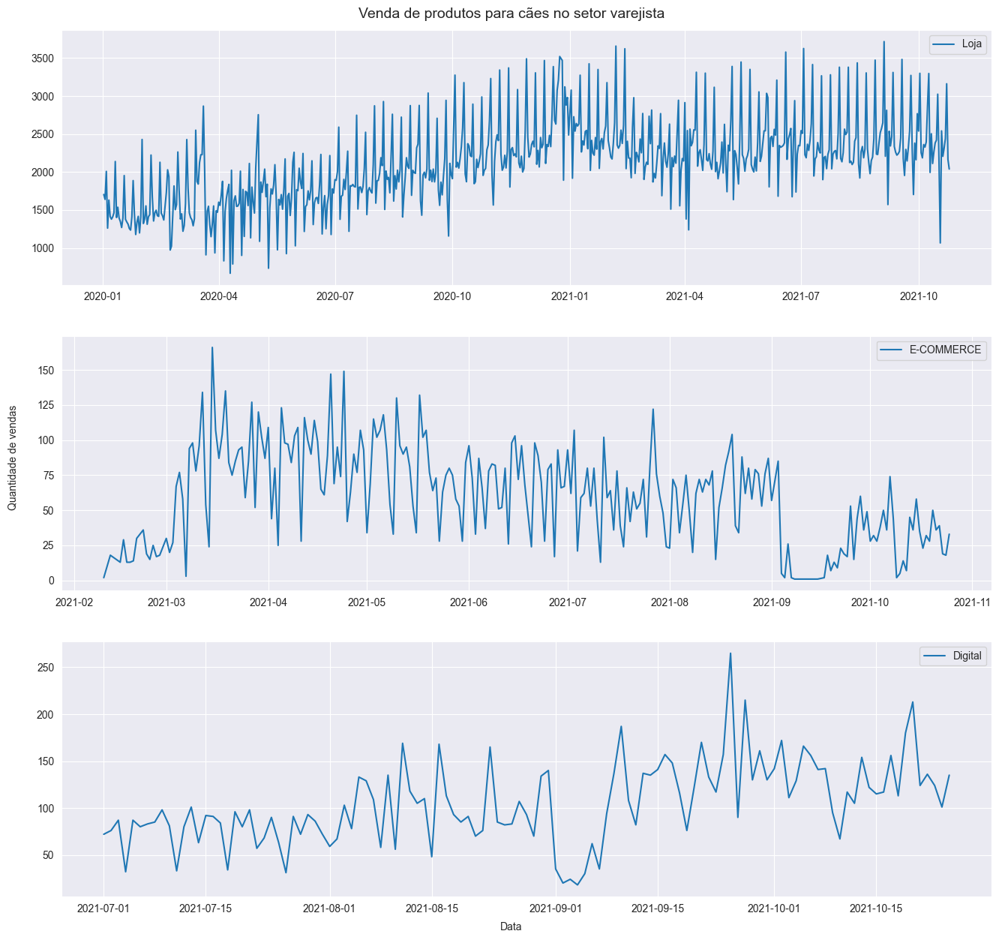

In [71]:
# Serie temporal da venda de produtos para cães

ts_caes_categoria = cliente_venda_produto_df.groupby(["DATA_VENDA","CATEGORIA_VENDA","NIVEL 1"]).QUANTIDADE.sum().reset_index()
ts_caes_categoria = ts_caes_categoria[ts_caes_categoria["NIVEL 1"]=="CAES"]
ts_caes_categoria.rename(columns={"ID_VENDA":"count_vendas"})

categorias_names_varejo = ts_categoria.CATEGORIA_VENDA.unique()[-3:]

fig,ax = plt.subplots(len(categorias_names_varejo),1,figsize=(16,15))

for i in range(len(categorias_names_varejo)):
  ts_cat = ts_caes_categoria[ts_caes_categoria.CATEGORIA_VENDA==categorias_names_varejo[i]]
  sns.lineplot(x = ts_cat.DATA_VENDA,y = ts_cat.QUANTIDADE,ax=ax[i])

  ax[i].legend([categorias_names_varejo[i]])
  ax[i].set_xlabel("")
  ax[i].set_ylabel("")

fig.suptitle("Venda de produtos para cães no setor varejista",y=0.9, fontsize=14)
fig.text(0.5, 0.08, 'Data', ha='center',fontsize=10)
fig.text(0.08, 0.5, 'Quantidade de vendas', va='center', rotation='vertical',fontsize=10)
fig.show()

Após analisar os dados, decidimos seguir com a Análise de Churn

# 3-) Engenharia de Variável

In [74]:
# Criação do dataset dos clientes adicionando se foi churnado
clientes_enr_df = clientes_df.merge(right = ultima_compra_clientes,how='left',on='ID_CLIENTE')
clientes_enr_df.dropna(subset=["mes_churn"],inplace=True)
clientes_enr_df.rename(columns={"DATA_VENDA":"ULTIMA_COMPRA"},inplace=True)
clientes_enr_df.set_index("ID_CLIENTE",inplace=True)
clientes_enr_df

,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn
ID_CLIENTE,,,,,,
20,NaN,NaT,2020-07-31,NaN,2021-10-13,Cliente ativo
186,NaN,NaT,2021-05-24,NaN,2021-05-26,2021/08
508,F,NaT,2020-09-22,NaN,2021-09-29,Cliente ativo
509,F,1992-01-22,2021-01-15,30.0,2021-10-21,Cliente ativo
510,M,1975-12-09,2020-09-22,46.0,2021-07-21,2021/10
...,...,...,...,...,...,...
94296,NaN,NaT,2021-07-25,NaN,2021-10-12,Cliente ativo
94298,NaN,NaT,2021-07-25,NaN,2021-07-25,2021/10
94299,F,1980-10-01,2021-07-25,41.0,2021-07-25,2021/10


In [75]:
# Criação da coluna de churn

def is_churn(s):
  if s=="Cliente ativo":
    return 0
  else:
    return 1
clientes_enr_df['churn'] = clientes_enr_df.mes_churn.apply(lambda s:is_churn(s))

#Transformação da coluna do mes_churn

clientes_enr_df.loc[clientes_enr_df.mes_churn == "Cliente ativo","mes_churn"] = np.nan
clientes_enr_df

,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn,churn
ID_CLIENTE,,,,,,,
20,NaN,NaT,2020-07-31,NaN,2021-10-13,NaN,0
186,NaN,NaT,2021-05-24,NaN,2021-05-26,2021/08,1
508,F,NaT,2020-09-22,NaN,2021-09-29,NaN,0
509,F,1992-01-22,2021-01-15,30.0,2021-10-21,NaN,0
510,M,1975-12-09,2020-09-22,46.0,2021-07-21,2021/10,1
...,...,...,...,...,...,...,...
94296,NaN,NaT,2021-07-25,NaN,2021-10-12,NaN,0
94298,NaN,NaT,2021-07-25,NaN,2021-07-25,2021/10,1
94299,F,1980-10-01,2021-07-25,41.0,2021-07-25,2021/10,1


C:\Users\douglas.souza\AppData\Local\Temp\ipykernel_15824\2578064968.py:7: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



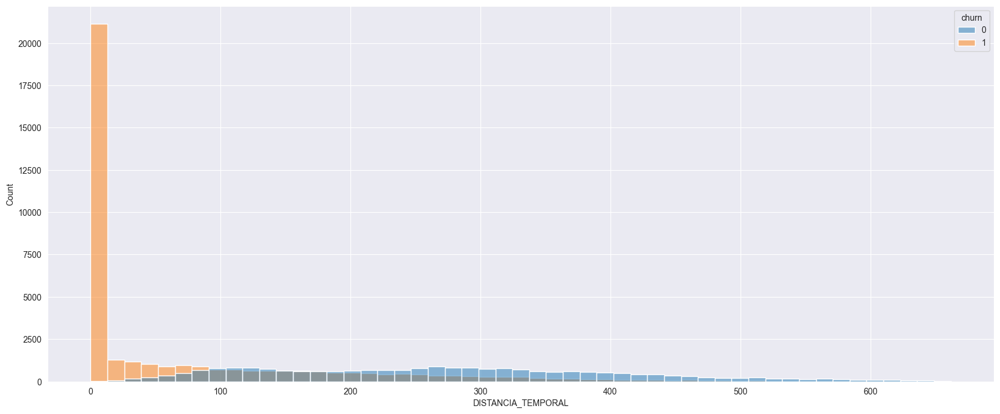

In [76]:
# Distancia temporal, em dias, entre primeira e ultima compra
# 0 = Não Churn - 1 = Churn
clientes_enr_df['DISTANCIA_TEMPORAL'] = (clientes_enr_df["ULTIMA_COMPRA"] - clientes_enr_df["PRIMEIRA_COMPRA"]).dt.days.astype(int,errors='ignore')

fig, ax = plt.subplots(figsize=(20,8))
sns.histplot(data = clientes_enr_df, x = "DISTANCIA_TEMPORAL",hue = 'churn',ax=ax)
fig.show()

Insight: Clientes com churn apresentam menores distancia de tempo entre primeira compra e ultima.

In [78]:
# Inserção do panorama geral de compra para cada cliente
#1 minuto para executar
cliente_agg_df = cliente_venda_produto_df.groupby("ID_CLIENTE").agg({"ID_VENDA":"nunique","CATEGORIA_VENDA":pd.Series.mode,
                                                    "NIVEL 1":pd.Series.mode,"NIVEL 2":pd.Series.mode,"NIVEL 3":pd.Series.mode,
                                                    "NIVEL 4":pd.Series.mode})

cliente_agg_df.rename(columns={"ID_VENDA":"QTD_COMPRAS","CATEGORIA_VENDA":"MODA_CATEGORIA_COMPRA",
                               "NIVEL 1":"MODA_COMPRA_NIVEL1","NIVEL 2":"MODA_COMPRA_NIVEL2",
                               "NIVEL 3":"MODA_COMPRA_NIVEL3","NIVEL 4":"MODA_COMPRA_NIVEL4"},inplace=True)

clientes_enr_df = clientes_enr_df.merge(right=cliente_agg_df,how='left',left_index=True,right_index=True)
clientes_enr_df

,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn,churn,DISTANCIA_TEMPORAL,QTD_COMPRAS,MODA_CATEGORIA_COMPRA,MODA_COMPRA_NIVEL1,MODA_COMPRA_NIVEL2,MODA_COMPRA_NIVEL3,MODA_COMPRA_NIVEL4
ID_CLIENTE,,,,,,,,,,,,,,
20.0,NaN,NaT,2020-07-31,NaN,2021-10-13,NaN,0,439,37,Loja,CAES,ALIMENTOS,RACOES,RACAO SECA
186.0,NaN,NaT,2021-05-24,NaN,2021-05-26,2021/08,1,2,2,Loja,CAES,ALIMENTOS,PETISCOS E OSSINHOS,OSSINHOS E PALITOS
508.0,F,NaT,2020-09-22,NaN,2021-09-29,NaN,0,372,9,Loja,GATOS,HIGIENE E BELEZA,HIGIENE E LIMPEZA,AREIAS E GRANULADOS
509.0,F,1992-01-22,2021-01-15,30.0,2021-10-21,NaN,0,279,29,Loja,CAES,ALIMENTOS,RACOES,RACAO SECA
510.0,M,1975-12-09,2020-09-22,46.0,2021-07-21,2021/10,1,302,8,Loja,"[AVES, CAES]",ALIMENTOS,RACOES,RACAO SECA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94296.0,NaN,NaT,2021-07-25,NaN,2021-10-12,NaN,0,79,5,Loja,CAES,ALIMENTOS,RACOES,"[RACAO SECA, ROUPA POS-CIRURGICA]"
94298.0,NaN,NaT,2021-07-25,NaN,2021-07-25,2021/10,1,0,1,Estética,[],[],[],[]
94299.0,F,1980-10-01,2021-07-25,41.0,2021-07-25,2021/10,1,0,1,Loja,CAES,ALIMENTOS,RACOES,RACAO SECA


### Análise e criação das variáveis relacionadas ao produto

In [79]:
nivel1_df = clientes_enr_df.explode("MODA_COMPRA_NIVEL1")[["MODA_COMPRA_NIVEL1",'churn']]
nivel2_df = clientes_enr_df.explode("MODA_COMPRA_NIVEL2")[["MODA_COMPRA_NIVEL2",'churn']]
nivel3_df = clientes_enr_df.explode("MODA_COMPRA_NIVEL3")[["MODA_COMPRA_NIVEL3",'churn']]
nivel4_df = clientes_enr_df.explode("MODA_COMPRA_NIVEL4")[["MODA_COMPRA_NIVEL4",'churn']]

nivel1_churn = nivel1_df.groupby('churn').MODA_COMPRA_NIVEL1.value_counts().to_frame().rename(columns={"MODA_COMPRA_NIVEL1":"value_count"}).reset_index()
nivel2_churn = nivel2_df.groupby('churn').MODA_COMPRA_NIVEL2.value_counts().to_frame().rename(columns={"MODA_COMPRA_NIVEL2":"value_count"}).reset_index()
nivel3_churn = nivel3_df.groupby('churn').MODA_COMPRA_NIVEL3.value_counts().to_frame().rename(columns={"MODA_COMPRA_NIVEL3":"value_count"}).reset_index()
nivel4_churn = nivel4_df.groupby('churn').MODA_COMPRA_NIVEL4.value_counts().to_frame().rename(columns={"MODA_COMPRA_NIVEL4":"value_count"}).reset_index()


px.bar(nivel1_churn,x = "MODA_COMPRA_NIVEL1",y="value_count",color='churn').show()
px.bar(nivel2_churn,x = "MODA_COMPRA_NIVEL2",y="value_count",color='churn').show()
px.bar(nivel3_churn,x = "MODA_COMPRA_NIVEL3",y="value_count",color='churn').show()
px.bar(nivel4_churn,x = "MODA_COMPRA_NIVEL4",y="value_count",color='churn').show()

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



In [80]:
n_nivel=1
for nivel in [nivel1_df,nivel2_df]:
  dist_nivel = nivel.drop(columns = "churn").reset_index().pivot(columns="MODA_COMPRA_NIVEL"+str(n_nivel))
  dist_nivel = dist_nivel.sum(axis=0)
  dist_nivel = dist_nivel/dist_nivel.sum()
  dist_nivel = dist_nivel.reset_index().drop(columns=["level_0"])

  display(dist_nivel.columns)
  fig = px.pie(names = dist_nivel["MODA_COMPRA_NIVEL"+str(n_nivel)],values=dist_nivel[0])
  fig.show()
  n_nivel+=1



Index(['MODA_COMPRA_NIVEL1', 0], dtype='object')

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Index(['MODA_COMPRA_NIVEL2', 0], dtype='object')

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

c:\Users\douglas.souza\Anaconda3\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



Insights:


*   Baixa distribuição no Nivel 1: 68% dos clientes são para cães.  
*   Moderada distribuição no Nivel 2, com 50% dos clientes tendo a maior parte das compras em alimento, já é uma distribuição mais aceitável.
*   Niveis 3 e 4 apresentam muitas categorias para serem usadas em modelos, e a sua representatividade no churn é explicada pelos niveis superiores, Nivel 1 e 2. No entanto, apresentam melhor distribuição.

Hipotese: Pelo balanço entre distribuição e explicabilidade do churn, o Nivel 2 parece ser o mais adequado para ser usado num modelo.





In [ ]:
# One Hot Encoding do Nivel 2 de produto

n2_encoding  = nivel2_df.pivot(columns="MODA_COMPRA_NIVEL2").reset_index().replace(0,1).replace(np.nan,0)
n2_encoding.columns = ["ID_CLIENTE","NaN","ACESSORIOS","ALIMENTOS","ANIMAL VIVO","AQUARIOS E ACESSORIOS","CASA","FARMACIA","HIGIENE E BELEZA"]
n2_encoding.drop(columns="NaN",inplace=True)
n2_encoding.set_index("ID_CLIENTE",inplace=True)
n2_encoding
clientes_enr_df = clientes_enr_df.merge(right=n2_encoding,how='left',left_index=True,right_index=True)

In [ ]:
clientes_enr_df.head()

,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn,churn,DISTANCIA_TEMPORAL,QTD_COMPRAS,MODA_CATEGORIA_COMPRA,...,MODA_COMPRA_NIVEL2,MODA_COMPRA_NIVEL3,MODA_COMPRA_NIVEL4,ACESSORIOS,ALIMENTOS,ANIMAL VIVO,AQUARIOS E ACESSORIOS,CASA,FARMACIA,HIGIENE E BELEZA
ID_CLIENTE,,,,,,,,,,,,,,,,,,,,,
20,NaN,NaT,2020-07-31,NaN,2021-10-13,NaN,0,439,37,Loja,...,ALIMENTOS,RACOES,RACAO SECA,0.0,1.0,0.0,0.0,0.0,0.0,0.0
186,NaN,NaT,2021-05-24,NaN,2021-05-26,2021/08,1,2,2,Loja,...,ALIMENTOS,PETISCOS E OSSINHOS,OSSINHOS E PALITOS,0.0,1.0,0.0,0.0,0.0,0.0,0.0
508,F,NaT,2020-09-22,NaN,2021-09-29,NaN,0,372,9,Loja,...,HIGIENE E BELEZA,HIGIENE E LIMPEZA,AREIAS E GRANULADOS,0.0,0.0,0.0,0.0,0.0,0.0,1.0
509,F,1992-01-22,2021-01-15,30.0,2021-10-21,NaN,0,279,29,Loja,...,ALIMENTOS,RACOES,RACAO SECA,0.0,1.0,0.0,0.0,0.0,0.0,0.0
510,M,1975-12-09,2020-09-22,46.0,2021-07-21,2021/10,1,302,8,Loja,...,ALIMENTOS,RACOES,RACAO SECA,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Frequencia de compra do cliente, em dias/compra(quantos dias demora para realizar uma nova compra)
clientes_enr_df['FREQUENCIA'] = clientes_enr_df['DISTANCIA_TEMPORAL']/clientes_enr_df["QTD_COMPRAS"]

#RECÊNCIA
data_atual = clientes_enr_df.PRIMEIRA_COMPRA.max() # considera ultima data da base para este case
clientes_enr_df['RECENCIA'] = (data_atual -  clientes_enr_df['ULTIMA_COMPRA']).dt.days

#Quantidade média de produtos comprados por venda
QTD_POR_VENDA = vendas_df.groupby(["ID_CLIENTE"]).agg({"ID_PRODUTO":"count","ID_VENDA":"nunique"})
QTD_POR_VENDA['QTD_POR_VENDA'] = QTD_POR_VENDA["ID_PRODUTO"]/QTD_POR_VENDA["ID_VENDA"]
clientes_enr_df = clientes_enr_df.merge(right=QTD_POR_VENDA.QTD_POR_VENDA,how='left',left_index=True,right_index=True)

In [ ]:
# Distancias entre 4 compras consecutivas
# MUITO DEMORADO!!!!!: aproximadamente 25 minutos
def ts_cliente(compras_cliente):
  try:
    compras_cliente = compras_cliente.groupby("ID_VENDA").agg({"DATA_VENDA":pd.Series.mode}).sort_values(by="DATA_VENDA",ascending=False)
    compras_cliente.loc[1] = np.nan
    compras_cliente.loc[2] = np.nan
    compras_cliente.loc[3] = np.nan
    time_diff = compras_cliente.DATA_VENDA.diff(-1).dt.days.astype(int,errors='ignore').values

    return np.resize(time_diff,(3,))
  except:
    return None

for c in clientes_enr_df.index:
  compras_cliente = vendas_df[vendas_df.ID_CLIENTE==c]
  clientes_enr_df.loc[c,["DT_1","DT_2","DT_3"]] = ts_cliente(compras_cliente)
clientes_enr_df

,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn,churn,DISTANCIA_TEMPORAL,QTD_COMPRAS,MODA_CATEGORIA_COMPRA,...,AQUARIOS E ACESSORIOS,CASA,FARMACIA,HIGIENE E BELEZA,FREQUENCIA,RECENCIA,QTD_POR_VENDA,DT_1,DT_2,DT_3
ID_CLIENTE,,,,,,,,,,,,,,,,,,,,,
20,NaN,NaT,2020-07-31,NaN,2021-10-13,NaN,0,439,37,Loja,...,0.0,0.0,0.0,0.0,11.864865,-80,2.540541,5.0,22.0,16.0
186,NaN,NaT,2021-05-24,NaN,2021-05-26,2021/08,1,2,2,Loja,...,0.0,0.0,0.0,0.0,1.000000,60,4.000000,2.0,NaN,NaN
508,F,NaT,2020-09-22,NaN,2021-09-29,NaN,0,372,9,Loja,...,0.0,0.0,0.0,1.0,41.333333,-66,1.333333,20.0,115.0,14.0
509,F,1992-01-22,2021-01-15,30.0,2021-10-21,NaN,0,279,29,Loja,...,0.0,0.0,0.0,0.0,9.620690,-88,1.655172,7.0,27.0,8.0
510,M,1975-12-09,2020-09-22,46.0,2021-07-21,2021/10,1,302,8,Loja,...,0.0,0.0,0.0,0.0,37.750000,4,1.250000,65.0,20.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94296,NaN,NaT,2021-07-25,NaN,2021-10-12,NaN,0,79,5,Loja,...,0.0,0.0,0.0,0.0,15.800000,-79,2.200000,38.0,11.0,5.0
94298,NaN,NaT,2021-07-25,NaN,2021-07-25,2021/10,1,0,1,Estética,...,0.0,0.0,0.0,0.0,0.000000,0,1.000000,NaN,NaN,NaN
94299,F,1980-10-01,2021-07-25,41.0,2021-07-25,2021/10,1,0,1,Loja,...,0.0,0.0,0.0,0.0,0.000000,0,1.000000,NaN,NaN,NaN


In [ ]:
#Ajustado a distancia temporal entre a ultima e penultima compra para clientes com apenas 1 compra
clientes_enr_df.loc[clientes_enr_df.QTD_COMPRAS==1,"DT_1"] = 0

In [ ]:
# One hot encoding do SEXO
pd.get_dummies(data = clientes_enr_df, columns = ["SEXO"],drop_first=True)

,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn,churn,DISTANCIA_TEMPORAL,QTD_COMPRAS,MODA_CATEGORIA_COMPRA,MODA_COMPRA_NIVEL1,...,FARMACIA,HIGIENE E BELEZA,FREQUENCIA,RECENCIA,QTD_POR_VENDA,DT_1,DT_2,DT_3,SEXO_M,SEXO_O
ID_CLIENTE,,,,,,,,,,,,,,,,,,,,,
20,NaT,2020-07-31,NaN,2021-10-13,NaN,0,439,37,Loja,CAES,...,0.0,0.0,11.864865,-80,2.540541,5.0,22.0,16.0,0,0
186,NaT,2021-05-24,NaN,2021-05-26,2021/08,1,2,2,Loja,CAES,...,0.0,0.0,1.000000,60,4.000000,2.0,NaN,NaN,0,0
508,NaT,2020-09-22,NaN,2021-09-29,NaN,0,372,9,Loja,GATOS,...,0.0,1.0,41.333333,-66,1.333333,20.0,115.0,14.0,0,0
509,1992-01-22,2021-01-15,30.0,2021-10-21,NaN,0,279,29,Loja,CAES,...,0.0,0.0,9.620690,-88,1.655172,7.0,27.0,8.0,0,0
510,1975-12-09,2020-09-22,46.0,2021-07-21,2021/10,1,302,8,Loja,"[AVES, CAES]",...,0.0,0.0,37.750000,4,1.250000,65.0,20.0,34.0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94296,NaT,2021-07-25,NaN,2021-10-12,NaN,0,79,5,Loja,CAES,...,0.0,0.0,15.800000,-79,2.200000,38.0,11.0,5.0,0,0
94298,NaT,2021-07-25,NaN,2021-07-25,2021/10,1,0,1,Estética,[],...,0.0,0.0,0.000000,0,1.000000,0.0,NaN,NaN,0,0
94299,1980-10-01,2021-07-25,41.0,2021-07-25,2021/10,1,0,1,Loja,CAES,...,0.0,0.0,0.000000,0,1.000000,0.0,NaN,NaN,0,0


In [ ]:
#Inserção do timedelta da primeira compra que o cliente fez, em meses
inicio_compras = ((dt.datetime.strptime("2022-09-17","%Y-%m-%d") - pd.to_datetime(clientes_enr_df.PRIMEIRA_COMPRA[clientes_enr_df.PRIMEIRA_COMPRA.isnull()==False]))/30).dt.days
inicio_compras.rename("INICIO_COMPRAS")
clientes_enr_df.loc[clientes_enr_df.PRIMEIRA_COMPRA.isnull().index,"INICIO_COMPRAS"] = inicio_compras

# 4-) Seleção de Variáveis

In [ ]:
clientes_enr_df.columns

Index(['SEXO', 'DATA_NASCIMENTO', 'PRIMEIRA_COMPRA', 'idade', 'ULTIMA_COMPRA',
       'mes_churn', 'churn', 'DISTANCIA_TEMPORAL', 'QTD_COMPRAS',
       'MODA_CATEGORIA_COMPRA', 'MODA_COMPRA_NIVEL1', 'MODA_COMPRA_NIVEL2',
       'MODA_COMPRA_NIVEL3', 'MODA_COMPRA_NIVEL4', 'ACESSORIOS', 'ALIMENTOS',
       'ANIMAL VIVO', 'AQUARIOS E ACESSORIOS', 'CASA', 'FARMACIA',
       'HIGIENE E BELEZA', 'FREQUENCIA', 'RECENCIA', 'QTD_POR_VENDA', 'DT_1',
       'DT_2', 'DT_3', 'INICIO_COMPRAS'],
      dtype='object')

In [ ]:
# Escolha das possiveis features, baseado na EDA.
df = clientes_enr_df.iloc[:,5:].drop(columns=["MODA_CATEGORIA_COMPRA","MODA_COMPRA_NIVEL1", "MODA_COMPRA_NIVEL2","MODA_COMPRA_NIVEL3","MODA_COMPRA_NIVEL4",
                                              'DT_1','DT_2', 'DT_3',])

df.drop(index = df[df.QTD_COMPRAS>100].index,inplace=True) # Outliers1: Retirada clientes com mais de 200 compras

In [ ]:
df.describe()

,churn,DISTANCIA_TEMPORAL,QTD_COMPRAS,ACESSORIOS,ALIMENTOS,ANIMAL VIVO,AQUARIOS E ACESSORIOS,CASA,FARMACIA,HIGIENE E BELEZA,FREQUENCIA,RECENCIA,QTD_POR_VENDA,INICIO_COMPRAS
count,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000,60509.000000
mean,0.628072,144.551653,5.297328,0.184518,0.586789,0.003999,0.007850,0.001306,0.127700,0.126312,28.074291,78.597498,2.102735,20.928424
std,0.483323,154.977903,7.218190,0.387909,0.492414,0.063115,0.088253,0.036110,0.333758,0.332203,35.710083,151.889622,1.540155,4.647445
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-93.000000,1.000000,13.000000
25%,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-51.000000,1.000000,17.000000
50%,1.000000,98.000000,3.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000,38.000000,1.666667,21.000000
75%,1.000000,256.000000,6.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,40.666667,175.000000,2.500000,24.000000
max,1.000000,662.000000,98.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,455.000000,570.000000,44.000000,32.000000


Insights:


*   Pouco desvio padrão na quantidade de produtos comprados, por venda, dos clientes (QTD_POR_VENDA)
*   Os valores historicos , DT_1, DT_2 E DT_3 tem bastante valores nulos. DT_3 diminui muito a base, bem como DT_2, apenas DT_1 é interessante.



In [ ]:
matrix_coor_df = df.corr()
fig = px.imshow(matrix_coor_df, color_continuous_scale= px.colors.sequential.Blues)
fig.update_layout(width = 1000,height=1000,template="seaborn")
fig.show()

Insights:

*   Alimentos, Distancia Temporal,Quantidade de compras, Frequencia e Recência tem boas correlações lineares com churn. Acessorios e Farmacias também podem ser usados.
*   Farmacia e Acessorios são correlacionados com Alimentos.
*   Alimentos, Quantidade de compras e Frequencia são correlacionados com Distancia Temporal.
*   Alimento moderadamente correlacionado com Quantidade de compras.
*   Alimento moderadamente correlacionado com Frequencia.

**Utilizar: Quantidade de compras, Frequencia, Alimentos e Recência**





# 5-) Modelagem

In [ ]:
##Gráfico para mostrar a importância da Features

def plot_feature_importances(model, X, feature_importances):
    df_importance = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importances})
    df_importance = df_importance.set_index('Feature')

    ax = df_importance.sort_values(by='Importance', ascending = False).head(10).plot.barh(figsize=(5, 5))
    ax.invert_yaxis()

In [ ]:
##Plot da curva ROC

def plot_roc_curve(model, X_val, y_val, ax = None):
    roc_auc = roc_auc_score(y_val, model.predict(X_val))
    fpr, tpr, thresholds = roc_curve(y_val, model.predict_proba(X_val)[:,1])

    if ax is not None:
        ax.plot(fpr, tpr, label='AUC = %0.2f)' % roc_auc)
        ax.plot([0, 1], [0, 1],'r--')
        ax.set_xlabel('Taxa de Falsos Positivos')
        ax.set_ylabel('Taxa de Verdadeiros Positivos')
        ax.legend(loc="lower right")
    else:
        plt.figure()
        plt.plot(fpr, tpr, label='AUC = %0.2f)' % roc_auc)
        plt.plot([0, 1], [0, 1],'r--')
        plt.xlabel('Taxa de Falsos Positivos')
        plt.ylabel('Taxa de Verdadeiros Positivos')
        plt.title('Curva ROC')
        plt.legend(loc="lower right")
        plt.show()

### Regressão Logística

In [ ]:
seed = 10
features = ["DISTANCIA_TEMPORAL","FREQUENCIA"]
df.dropna(inplace=True,subset = features)
X_log = df.loc[:,features].values
y_log = df.loc[:,"churn"].values
print(f"X shape:{X_log.shape}")
print(f"y shape:{y_log.shape}")

X shape:(60509, 2)
y shape:(60509,)


In [ ]:
X_train,X_test,y_train,y_test = train_test_split(X_log,y_log,test_size=0.25,random_state = seed,stratify = y_log)
X_training,X_val,y_training,y_val = train_test_split(X_train,y_train,test_size=0.25,random_state = seed,stratify = y_train)

print(f"X_train shape:{X_training.shape}")
print(f"y_train shape:{y_training.shape}")

print(f"X_val shape:{X_val.shape}")
print(f"y_val shape:{y_val.shape}")

X_train shape:(34035, 2)
y_train shape:(34035,)
X_val shape:(11346, 2)
y_val shape:(11346,)


In [ ]:
rf = LogisticRegression()

rf.fit(X_training,y_training)

print(f"Score para treino:{rf.score(X_training,y_training)}")
print(f"Score para validação:{rf.score(X_val,y_val)}")

Score para treino:0.7891582194799471
Score para validação:0.786003878018685


In [ ]:
from sklearn.metrics import confusion_matrix,classification_report,roc_auc_score

y_pred = rf.predict(X_val)

print(confusion_matrix(y_val,y_pred))
print(classification_report(y_val,y_pred))
print(f"AUC:{roc_auc_score(y_val,y_pred)}")

[[2659 1561]
 [ 867 6259]]
              precision    recall  f1-score   support

           0       0.75      0.63      0.69      4220
           1       0.80      0.88      0.84      7126

    accuracy                           0.79     11346
   macro avg       0.78      0.75      0.76     11346
weighted avg       0.78      0.79      0.78     11346

AUC:0.754213826146293


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



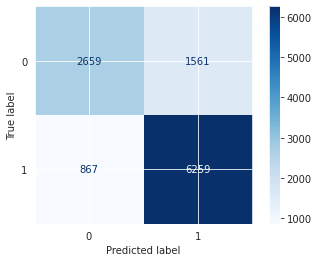

In [ ]:
plot_confusion_matrix(rf, X_val, y_val, cmap=plt.cm.Blues)

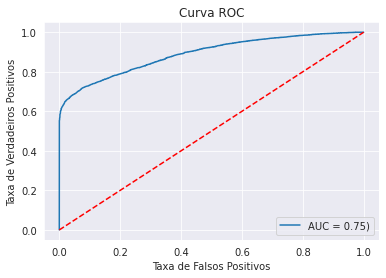

In [ ]:
plot_roc_curve(rf, X_val, y_val)

Ideia: Resultado não estar muito ruim, é necessario pensar mais na parte de engenharia de variaveis, bem como dropar a parte que corresponde aos clientes Digital e clientes que são outliers em diversas features.

### Decision Tree

In [ ]:
features = ["RECENCIA"]
df.dropna(inplace=True,subset = features)
X = df.drop(columns = ['mes_churn','churn','RECENCIA'])
y = df.loc[:,"churn"]

In [ ]:
X.shape

(60509, 12)

In [ ]:
# Para os modelos que iremos usar, não podemos ter variáveis nulas, vamos verificar se isso está sendo respeitado
null_cols = X.isnull().sum() > 1
null_cols[null_cols]

Series([], dtype: bool)

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
SEED = 19

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, stratify=y, random_state=SEED)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.30, stratify=y_train, random_state=SEED)

In [ ]:

# Definir os possiveis valores para cada hiperparametro para serem explorados

# tirar e perguntar para eles
params = {'max_depth': [2, 3, 4, 5, 6, 7, 8, 9],
          'min_samples_split': [2, 3, 4, 5, 6],
          'min_samples_leaf': [1, 2, 3]}

# # Criar objeto com o DecisionTreeClassifier
tree = DecisionTreeClassifier(random_state=SEED)

# # Criar objeto KFold com StratifiedKFold para validação cruzada
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=SEED)

# # Criar um objeto de grade de busca com GridSearchCV
grid_search = GridSearchCV(tree, param_grid=params, scoring='roc_auc',
                           cv=skf.split(X_train, y_train))

# Treinar o modelo com o grid search
grid_search.fit(X_train, y_train)
print('Melhores hiperparâmetros:')
print(grid_search.best_params_)


# --> Criação do modelo com as melhores combinações de hiperparâmetros

tree = DecisionTreeClassifier(random_state=SEED, max_depth= grid_search.best_params_['max_depth'],
                                min_samples_split= grid_search.best_params_['min_samples_split'],
                                min_samples_leaf= grid_search.best_params_['min_samples_leaf'])

# Fita o modelo com o dataset de treino
tree.fit(X_train, y_train)

# Usa o modelo para prever o conjunto de validação
y_pred_tree = tree.predict(X_val)

Melhores hiperparâmetros:
{'max_depth': 8, 'min_samples_leaf': 3, 'min_samples_split': 2}


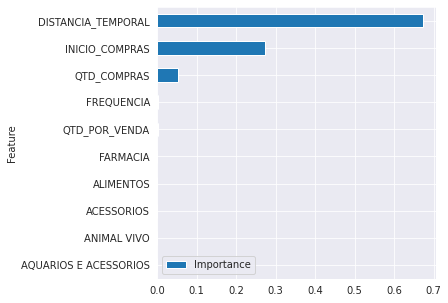

In [ ]:
plot_feature_importances(tree, X, tree.feature_importances_)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



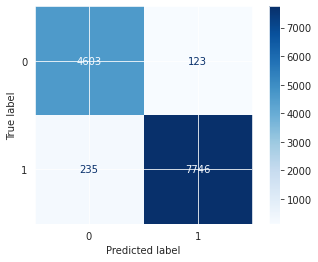

In [ ]:
plot_confusion_matrix(tree, X_val, y_val, cmap=plt.cm.Blues)

In [ ]:
print("Acurácia Treino: {:.3f}".format(tree.score(X_train, y_train)))
print("Acurácia Validação: {:.3f}\n".format(tree.score(X_val, y_val)))
print(classification_report(y_val, y_pred_tree))
print("Área sob a curva ROC: {:.3f}".format(roc_auc_score(y_val, y_pred_tree)))

Acurácia Treino: 0.977
Acurácia Validação: 0.972

              precision    recall  f1-score   support

           0       0.95      0.97      0.96      4726
           1       0.98      0.97      0.98      7981

    accuracy                           0.97     12707
   macro avg       0.97      0.97      0.97     12707
weighted avg       0.97      0.97      0.97     12707

Área sob a curva ROC: 0.972


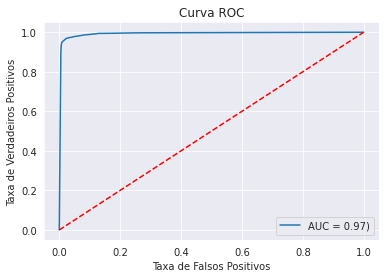

In [ ]:
plot_roc_curve(tree, X_val, y_val)

### Uso do melhor modelo na previsão dos dados de teste

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



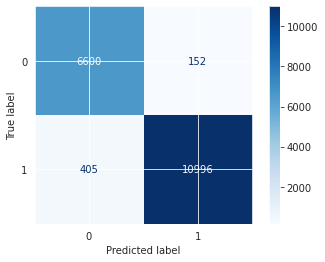

In [ ]:
plot_confusion_matrix(tree, X_test, y_test, cmap=plt.cm.Blues)

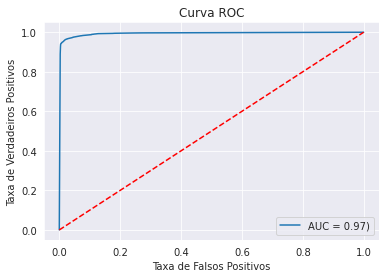

In [ ]:
plot_roc_curve(tree, X_test, y_test)

# 6-) Segmentação de Cliente

In [ ]:
clientes_enr_df.reset_index(inplace=True)
clientes = clientes_enr_df[['ID_CLIENTE','idade','QTD_POR_VENDA','INICIO_COMPRAS']].dropna()

# Base utilizada para clusterização
var_cluster = ['ID_CLIENTE','idade','QTD_POR_VENDA','INICIO_COMPRAS']

df_cluster = clientes[var_cluster]

# Normalização das variáveis
std_data = StandardScaler().fit_transform(df_cluster)
df_cluster = pd.DataFrame(data=std_data, columns=df_cluster.columns, index=df_cluster.index)

df_cluster.describe()

,ID_CLIENTE,idade,QTD_POR_VENDA,INICIO_COMPRAS
count,3.372400e+04,3.372400e+04,3.372400e+04,3.372400e+04
mean,3.371096e-16,-2.582575e-16,3.474336e-16,-4.854378e-16
std,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00
min,-4.222849e+00,-1.871506e+00,-8.275753e-01,-1.924831e+00
25%,-7.937688e-01,-7.418110e-01,-6.381770e-01,-7.749259e-01
50%,8.578378e-04,-4.661410e-02,-2.593802e-01,8.750277e-02
75%,8.182932e-01,6.485828e-01,3.088149e-01,6.624552e-01
max,1.833082e+00,2.734174e+00,2.360481e+01,3.537217e+00


In [ ]:
# Cálculo das iterações do k-means (Cotovelo)
# O número de iterações é subjetivo, utilizou-se 26, pois com esse número é possível avaliar
# o ponto de flexão da curva, mas se desejar é possível testar com valor maior ou menor

wcss = {}
for k in range(1, 26):
  print(k)
  kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=200, random_state=3)
  kmeans.fit(df_cluster)
  wcss[k] = kmeans.inertia_

# No código abaixo será gerado o gráfico que permite aplicação do método do "cotovelo"
fig = make_subplots(
    rows=1,
    cols=1,
    subplot_titles=['Método do Cotovelo'],
    shared_xaxes=True,
    shared_yaxes=False)


fig.add_trace(
    go.Scatter(
        x=list(wcss.keys()),
        y=list(wcss.values()),
        mode='lines+markers',
        textposition='top center',
        showlegend=False),
    row=1,
    col=1)

fig.update_xaxes(visible=True, title='No. of clusters',row=1, col=1)
fig.update_yaxes(visible=True, title='Cluster Inertia',row=1, col=1)

fig.update_layout(
  title='Definição do Nº Ideal de Clusters',
  showlegend=False,
  xaxis_showticklabels=True,
  height=400,
  width=800,
  xaxis = dict(
    tickmode = 'linear',
    tick0 = 0,
    dtick = 1))

fig.show()

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25


In [ ]:
# Definição do DF a ser Clusterizado
df_cluster_km = df_cluster.copy()

# Clusterização
clus = KMeans(n_clusters=4, init='k-means++', max_iter=300,random_state=3)
clus.fit(df_cluster_km)

# Ajustando as colunas
df_cluster_km.loc[:, 'CLUSTER'] = clus.labels_
df_cluster_km.head()

,ID_CLIENTE,idade,QTD_POR_VENDA,INICIO_COMPRAS,CLUSTER
3,-4.222849,-0.915610,-0.455310,0.087503,3
4,-4.222784,0.474784,-0.685527,1.237408,3
5,-4.222720,0.909282,-0.786990,1.237408,3
6,-4.222655,0.474784,4.286181,1.237408,0
7,-4.222591,0.127185,-0.575044,1.237408,3


In [ ]:
# Inserção do cluster na base de clientes
clientes = pd.concat([clientes, df_cluster_km[['CLUSTER']]], axis=1)

clientes.head()

,ID_CLIENTE,idade,QTD_POR_VENDA,INICIO_COMPRAS,CLUSTER
3,509,30.0,1.655172,20,3
4,510,46.0,1.250000,24,3
5,511,51.0,1.071429,24,3
6,512,46.0,10.000000,24,0
7,513,42.0,1.444444,24,3


In [ ]:
analise_volumetria = clientes.groupby('CLUSTER', as_index=False)['ID_CLIENTE'].count()
fig = px.bar(analise_volumetria, x="CLUSTER", y="ID_CLIENTE", title="# Clientes por Cluster")
fig.update_layout(
    width=600,
    height=400,
    showlegend=False)
fig.show()

In [ ]:
var_cluster = clientes.set_index(['ID_CLIENTE', 'CLUSTER']).columns.tolist()
print(f'Variáveis: {var_cluster}')

Variáveis: ['idade', 'QTD_POR_VENDA', 'INICIO_COMPRAS']


In [ ]:
# Analise do comportamento de uma variavel em função do Cluster

for var in var_cluster:
  fig = px.box(clientes, x=var, y='CLUSTER', points=False)
  fig.update_traces(orientation='h')
  fig.update_layout(
      title=f'Distribuição da {var} por Cluster',
      xaxis={'title': var},
      yaxis={'title': 'Cluster', 'showline': False, 'ticks': ''}
  )

  fig.update_layout(
      width=800,
      height=400,
      showlegend=False)

  fig.show()

In [ ]:
# Adicionando os clusters ao dataset enriquecido dos clientes

clientes_enr = clientes_enr_df.merge(right = clientes[["ID_CLIENTE","CLUSTER"]],how='left',on="ID_CLIENTE")
clientes_enr

,ID_CLIENTE,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn,churn,DISTANCIA_TEMPORAL,QTD_COMPRAS,...,FARMACIA,HIGIENE E BELEZA,FREQUENCIA,RECENCIA,QTD_POR_VENDA,DT_1,DT_2,DT_3,INICIO_COMPRAS,CLUSTER
0,20,NaN,NaT,2020-07-31,NaN,2021-10-13,NaN,0,439,37,...,0.0,0.0,11.864865,-80,2.540541,5.0,22.0,16.0,25,NaN
1,186,NaN,NaT,2021-05-24,NaN,2021-05-26,2021/08,1,2,2,...,0.0,0.0,1.000000,60,4.000000,2.0,NaN,NaN,16,NaN
2,508,F,NaT,2020-09-22,NaN,2021-09-29,NaN,0,372,9,...,0.0,1.0,41.333333,-66,1.333333,20.0,115.0,14.0,24,NaN
3,509,F,1992-01-22,2021-01-15,30.0,2021-10-21,NaN,0,279,29,...,0.0,0.0,9.620690,-88,1.655172,7.0,27.0,8.0,20,3.0
4,510,M,1975-12-09,2020-09-22,46.0,2021-07-21,2021/10,1,302,8,...,0.0,0.0,37.750000,4,1.250000,65.0,20.0,34.0,24,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60514,94296,NaN,NaT,2021-07-25,NaN,2021-10-12,NaN,0,79,5,...,0.0,0.0,15.800000,-79,2.200000,38.0,11.0,5.0,13,NaN
60515,94298,NaN,NaT,2021-07-25,NaN,2021-07-25,2021/10,1,0,1,...,0.0,0.0,0.000000,0,1.000000,0.0,NaN,NaN,13,NaN
60516,94299,F,1980-10-01,2021-07-25,41.0,2021-07-25,2021/10,1,0,1,...,0.0,0.0,0.000000,0,1.000000,0.0,NaN,NaN,13,1.0
60517,94300,M,1973-07-11,2021-07-25,49.0,2021-09-15,NaN,0,52,3,...,0.0,0.0,17.333333,-52,4.333333,41.0,11.0,NaN,13,1.0


In [ ]:
categorias = produtos_df['NIVEL 1'].unique()
clientes_enr_df[(clientes_enr_df.MODA_COMPRA_NIVEL1.isin(categorias))]


,ID_CLIENTE,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,ULTIMA_COMPRA,mes_churn,churn,DISTANCIA_TEMPORAL,QTD_COMPRAS,...,CASA,FARMACIA,HIGIENE E BELEZA,FREQUENCIA,RECENCIA,QTD_POR_VENDA,DT_1,DT_2,DT_3,INICIO_COMPRAS
0,20,NaN,NaT,2020-07-31,NaN,2021-10-13,NaN,0,439,37,...,0.0,0.0,0.0,11.864865,-80,2.540541,5.0,22.0,16.0,25
1,186,NaN,NaT,2021-05-24,NaN,2021-05-26,2021/08,1,2,2,...,0.0,0.0,0.0,1.000000,60,4.000000,2.0,NaN,NaN,16
2,508,F,NaT,2020-09-22,NaN,2021-09-29,NaN,0,372,9,...,0.0,0.0,1.0,41.333333,-66,1.333333,20.0,115.0,14.0,24
3,509,F,1992-01-22,2021-01-15,30.0,2021-10-21,NaN,0,279,29,...,0.0,0.0,0.0,9.620690,-88,1.655172,7.0,27.0,8.0,20
5,511,F,1970-12-19,2020-09-22,51.0,2021-10-23,NaN,0,396,14,...,0.0,0.0,0.0,28.285714,-90,1.071429,30.0,35.0,29.0,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60512,94294,NaN,NaT,2021-07-25,NaN,2021-09-23,NaN,0,60,3,...,0.0,0.0,0.0,20.000000,-60,1.333333,26.0,34.0,NaN,13
60513,94295,F,1980-08-27,2021-07-25,42.0,2021-07-25,2021/10,1,0,1,...,0.0,0.0,0.0,0.000000,0,1.000000,0.0,NaN,NaN,13
60514,94296,NaN,NaT,2021-07-25,NaN,2021-10-12,NaN,0,79,5,...,0.0,0.0,0.0,15.800000,-79,2.200000,38.0,11.0,5.0,13
60516,94299,F,1980-10-01,2021-07-25,41.0,2021-07-25,2021/10,1,0,1,...,0.0,0.0,0.0,0.000000,0,1.000000,0.0,NaN,NaN,13


In [ ]:
# Funcão para plotar distribuicao comparativa entre clusters
def plot_wrap_bar(df, coluna, valor, aggfunc, tipo):
  df_plt = df.groupby(['CLUSTER', coluna])[[valor]].agg(aggfunc)
  df_plt.columns=['VALOR']

  df_plt['TOTAL'] = df_plt.groupby(['CLUSTER'])[['VALOR']].transform('sum')
  df_plt['PERCENTUAL'] = round((df_plt['VALOR']/df_plt['TOTAL']),2)

  df_plt = df_plt.reset_index()

  fig = px.bar(df_plt, y="CLUSTER", x=tipo,
              color='CLUSTER', facet_col=coluna,
              facet_col_wrap=3, orientation='h',)
  fig.update_layout(
      title={
          'text': coluna + '-' + valor + '-' + tipo,
          'y':1
          },
      height=500,
      width=800)

  fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[1]))
  fig.show()

  return df_plt

In [ ]:
linha = plot_wrap_bar(df=clientes_enr[(clientes_enr.MODA_COMPRA_NIVEL1.isin(produtos_df['NIVEL 1'].unique()))],
              coluna='MODA_COMPRA_NIVEL1',
              valor='QTD_COMPRAS',
              aggfunc='sum',
              tipo='PERCENTUAL')

In [ ]:
linha = plot_wrap_bar(df=clientes_enr[(clientes_enr.MODA_COMPRA_NIVEL2.isin(produtos_df['NIVEL 2'].unique()))],
              coluna='MODA_COMPRA_NIVEL2',
              valor='QTD_COMPRAS',
              aggfunc='sum',
              tipo='PERCENTUAL')

In [ ]:
linha = plot_wrap_bar(df=clientes_enr[(clientes_enr.MODA_CATEGORIA_COMPRA.isin(vendas_df['CATEGORIA_VENDA'].unique()))],
              coluna='MODA_CATEGORIA_COMPRA',
              valor='QTD_COMPRAS',
              aggfunc='sum',
              tipo='PERCENTUAL')

In [ ]:
linha = plot_wrap_bar(df=clientes_enr[(clientes_enr.MODA_COMPRA_NIVEL2.isin(produtos_df['NIVEL 2'].unique()))],
              coluna='churn',
              valor='QTD_COMPRAS',
              aggfunc='sum',
              tipo='PERCENTUAL')

Insights: REVISAR!!


*   Clientes do cluster 0, que compram bastante produtos por venda, costumam comprar mais acessórios e apresentam a maior taxa de churn na segmentação feita. São os  clientes que mais compram para peixes.
*   Clientes do cluster 3 são os que apresentam menor idade e tem 30% de churn.
*   Clientes do cluster 2 tem sua faixa etária iniciando em 49 anos.
*   Clientes do custer 1 são os mais recentes na vai PET.













# 7-) Recomendação de Produto

In [ ]:
cliente_venda_produto_short_df = cliente_venda_produto_df.copy()
cliente_venda_produto_short_df.drop(cliente_venda_produto_short_df[cliente_venda_produto_short_df['DATA_VENDA']<'2020-03-31'].index, inplace = True)
cliente_venda_produto_short_df.drop(cliente_venda_produto_short_df[cliente_venda_produto_short_df['DATA_VENDA']>'2021-10-31'].index, inplace = True)
cliente_venda_produto_short_df.describe(include = 'all')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



,ID_VENDA,DATA_VENDA,ID_CLIENTE,ID_PRODUTO,QUANTIDADE,CATEGORIA_VENDA,FILIAL,SEXO,DATA_NASCIMENTO,PRIMEIRA_COMPRA,idade,UNIDADE,NIVEL 1,NIVEL 2,NIVEL 3,NIVEL 4,NIVEL 1+2
count,1.675158e+06,1675158,911481.000000,1.675158e+06,1.675158e+06,1675158,1.675158e+06,429566,399246,642765,399246.000000,1560335,1558503,1558503,1544754,1391732,1558503
unique,NaN,575,NaN,NaN,NaN,5,NaN,3,14119,570,NaN,12,6,7,31,61,26
top,NaN,2021-07-03 00:00:00,NaN,NaN,NaN,Loja,NaN,F,2000-07-21 00:00:00,2020-11-14 00:00:00,NaN,UN,CAES,ALIMENTOS,RACOES,RACAO SECA,CAES - ALIMENTOS
freq,NaN,4965,NaN,NaN,NaN,1528158,NaN,262303,460,4505,NaN,1525305,1108873,783272,547042,297388,511921
first,NaN,2020-03-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,1950-01-03 00:00:00,2020-01-02 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2021-10-26 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,2002-12-26 00:00:00,2021-07-25 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,4.476768e+05,NaN,49470.580825,1.765193e+04,9.810442e+00,NaN,1.035057e+02,NaN,NaN,NaN,41.352382,NaN,NaN,NaN,NaN,NaN,NaN
std,2.413108e+05,NaN,25985.763375,1.173401e+04,9.239322e+01,NaN,2.271379e+00,NaN,NaN,NaN,11.403044,NaN,NaN,NaN,NaN,NaN,NaN
min,0.000000e+00,NaN,7.000000,0.000000e+00,0.000000e+00,NaN,1.010000e+02,NaN,NaN,NaN,19.000000,NaN,NaN,NaN,NaN,NaN,NaN
25%,2.356182e+05,NaN,30641.000000,7.764000e+03,1.000000e+00,NaN,1.020000e+02,NaN,NaN,NaN,33.000000,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
cvp_short_df= cliente_venda_produto_short_df[['ID_VENDA', 'ID_CLIENTE','ID_PRODUTO', 'QUANTIDADE','NIVEL 1','NIVEL 2','NIVEL 3', 'NIVEL 4']].copy()


# Dropping the rows without any invoice number
cvp_short_df.dropna(axis = 0, subset =['ID_VENDA'], inplace = True)
cvp_short_df['ID_VENDA'] = cvp_short_df['ID_VENDA'].astype('str')
cvp_short_df['ID_CLIENTE'] = cvp_short_df['ID_CLIENTE'].astype('str')
cvp_short_df['ID_PRODUTO'] = cvp_short_df['ID_PRODUTO'].astype('str')
display(cvp_short_df.info())
display(cvp_short_df['NIVEL 4'].unique())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1675158 entries, 0 to 1859582
Data columns (total 8 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   ID_VENDA    1675158 non-null  object 
 1   ID_CLIENTE  1675158 non-null  object 
 2   ID_PRODUTO  1675158 non-null  object 
 3   QUANTIDADE  1675158 non-null  float64
 4   NIVEL 1     1558503 non-null  object 
 5   NIVEL 2     1558503 non-null  object 
 6   NIVEL 3     1544754 non-null  object 
 7   NIVEL 4     1391732 non-null  object 
dtypes: float64(1), object(7)
memory usage: 115.0+ MB


None

array(['BISCOITOS - BIFINHOS - SNACKS', 'ALMOFADAS E COLCHONETES',
       'VITAMINAS E SUPLEMENTOS', 'TRATAMENTO DIGESTIVO',
       'FRALDAS, CALCINHAS E LENCOS', 'RACAO MEDICAMENTOSA', 'RACAO SECA',
       'TRATAMENTO PARA ORELHAS', 'ANTIPULGAS E CARRAPATOS',
       'OSSINHOS E PALITOS', nan, 'COMEDOUROS E BEBEDOUROS',
       'BANHO TERAPEUTICO', 'ANTIBIOTICOS', 'AREIAS E GRANULADOS',
       'RACAO UMIDA (SACHES E LATAS)', 'TRATAMENTO PARA PELE',
       'COLETOR DE FEZES', 'ANTI-INFLAMATORIOS', 'PARA MORDER E PUXAR',
       'TAPETES HIGIENICOS', 'MODA INVERNO', 'TRATAMENTO PARA OLHOS',
       'SHAMPOOS E COSMETICOS', 'CATNIP E GRAMINHAS',
       'PENTES - ESCOVAS - LUVAS', 'ELIMINADOR DE ODORES', 'SANITARIOS',
       'PORTA RACOES E ACESSORIOS', 'CERCADOS E PORTOES',
       'CINTOS DE SEGURANCA', 'TRATAMENTO DENTARIO',
       'PELUCIA - VINIL - LATEX', 'EDUCADORES E ACESSORIOS', 'VERMIFUGOS',
       'PARA JOGAR E PEGAR', 'PEITORAIS', 'TRATAMENTO RESPIRATORIO',
       'TRATAMENTO CARDI

In [ ]:
setor = (cvp_short_df.groupby(['ID_VENDA', 'NIVEL 3'])['QUANTIDADE'].sum().unstack().reset_index().fillna(0).set_index('ID_VENDA'))
display(setor.info())
display(setor.head())

<class 'pandas.core.frame.DataFrame'>
Index: 683485 entries, 0 to 99998
Data columns (total 31 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   ACESSORIOS MEDICOS            683485 non-null  float64
 1   ACESSORIOS PARA ALIMENTACAO   683485 non-null  float64
 2   ADESTRAMENTO E COMPORTAMENTO  683485 non-null  float64
 3   AQUARIOS                      683485 non-null  float64
 4   BOMBAS E CONDICIONADORES      683485 non-null  float64
 5   BRINQUEDOS                    683485 non-null  float64
 6   CAMINHAS E CASINHAS           683485 non-null  float64
 7   COLEIRAS E PEITORAIS          683485 non-null  float64
 8   DECORACAO                     683485 non-null  float64
 9   DECORACAO E ILUMINACAO        683485 non-null  float64
 10  DEMAIS MEDICAMENTOS           683485 non-null  float64
 11  DOCES                         683485 non-null  float64
 12  DORES E INFECCOES             683485 non-null  flo

None

NIVEL 3,ACESSORIOS MEDICOS,ACESSORIOS PARA ALIMENTACAO,ADESTRAMENTO E COMPORTAMENTO,AQUARIOS,BOMBAS E CONDICIONADORES,BRINQUEDOS,CAMINHAS E CASINHAS,COLEIRAS E PEITORAIS,DECORACAO,DECORACAO E ILUMINACAO,...,PORTOES - GRADES - ESCADAS,PULGAS - CARRAPATOS - VERMES,RACOES,RACOES - FENOS - ALFAFAS,ROUPINHAS E ACESSORIOS,SALGADOS,SUPLEMENTOS E VITAMINAS,TRANSPORTE E VIAGEM,UTENSILIOS PARA BANHO,VITAMINAS E SUPLEMENTOS
ID_VENDA,,,,,,,,,,,,,,,,,,,,,
0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,8.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,3.0,1.0,8.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
10,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,9.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
100,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1000,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
#definição da função hot_encode() obs: get_dummies não funciona
def hot_encode(x):
    if(x<= 0):
        return 0
    if(x>= 1):
        return 1

In [ ]:
#aplicando hot_encode na cesta do setor geral
setor_encoded = setor.applymap(hot_encode)
setor_encoded.head()

NIVEL 3,ACESSORIOS MEDICOS,ACESSORIOS PARA ALIMENTACAO,ADESTRAMENTO E COMPORTAMENTO,AQUARIOS,BOMBAS E CONDICIONADORES,BRINQUEDOS,CAMINHAS E CASINHAS,COLEIRAS E PEITORAIS,DECORACAO,DECORACAO E ILUMINACAO,...,PORTOES - GRADES - ESCADAS,PULGAS - CARRAPATOS - VERMES,RACOES,RACOES - FENOS - ALFAFAS,ROUPINHAS E ACESSORIOS,SALGADOS,SUPLEMENTOS E VITAMINAS,TRANSPORTE E VIAGEM,UTENSILIOS PARA BANHO,VITAMINAS E SUPLEMENTOS
ID_VENDA,,,,,,,,,,,,,,,,,,,,,
0,0,1,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,1,0
1,0,0,0,0,0,0,1,0,0,0,...,1,1,1,1,0,0,0,0,1,0
10,0,1,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
100,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
1000,0,1,0,0,0,0,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0


In [ ]:
# Building the model
freq_setor = apriori(setor_encoded, min_support = 0.015, use_colnames = True)
display(freq_setor.head())

# Collecting the inferred rules in a dataframe
regra_setor = association_rules(freq_setor, metric ="lift", min_threshold = 1)
regra_setor = regra_setor.sort_values(['confidence', 'lift'], ascending =[False, False])
display(regra_setor.head())

,support,itemsets
0,0.054221,(ACESSORIOS PARA ALIMENTACAO)
1,0.024780,(ADESTRAMENTO E COMPORTAMENTO)
2,0.126579,(BRINQUEDOS)
3,0.018802,(CAMINHAS E CASINHAS)
4,0.051103,(COLEIRAS E PEITORAIS)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
3,(ACESSORIOS PARA ALIMENTACAO),(HIGIENE E LIMPEZA),0.054221,0.221782,0.018621,0.343425,1.548478,0.006596,1.185269
1,(ACESSORIOS PARA ALIMENTACAO),(BRINQUEDOS),0.054221,0.126579,0.018196,0.335600,2.651304,0.011333,1.314601
14,"(BRINQUEDOS, RACOES)",(HIGIENE E LIMPEZA),0.048712,0.221782,0.016322,0.335075,1.510829,0.005519,1.170385
6,(BRINQUEDOS),(PETISCOS E OSSINHOS),0.126579,0.176114,0.033533,0.264914,1.504220,0.011240,1.120802
4,(BRINQUEDOS),(HIGIENE E LIMPEZA),0.126579,0.221782,0.033377,0.263688,1.188950,0.005304,1.056913


In [ ]:
def rules_to_coordinates(rules):
    rules['antecedent'] = rules['antecedents'].apply(lambda antecedent: list(antecedent)[0])
    rules['consequent'] = rules['consequents'].apply(lambda consequent: list(consequent)[0])
    rules['rule'] = rules.index
    return rules[['antecedent','consequent','rule']]

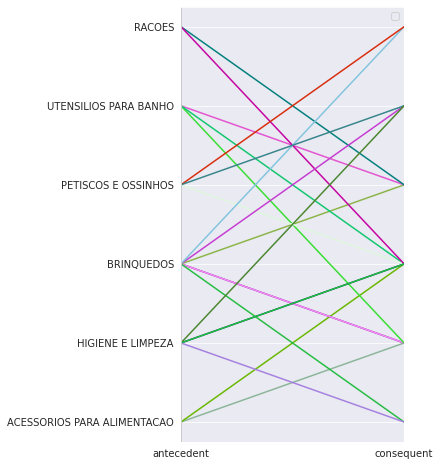

In [ ]:
# Convert rules into coordinates suitable for use in a parallel coordinates plot
coord_setor = rules_to_coordinates(regra_setor)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coord_setor, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

In [ ]:
tipo_prod = (cvp_short_df.groupby(['ID_VENDA', 'NIVEL 4'])['QUANTIDADE'].sum().unstack().reset_index().fillna(0).set_index('ID_VENDA'))
tipo_prod_encoded = tipo_prod.applymap(hot_encode)
tipo_prod_encoded.head()

NIVEL 4,ACESSORIOS FASHION,ALICATES E TESOURAS,ALMOFADAS E COLCHONETES,ANTI-INFLAMATORIOS,ANTIBIOTICOS,ANTIPULGAS E CARRAPATOS,AREIAS E GRANULADOS,ARRANHADORES,BANHO A SECO E TALCOS,BANHO TERAPEUTICO,...,TRATAMENTO CARDIACO,TRATAMENTO DENTARIO,TRATAMENTO DIGESTIVO,TRATAMENTO PARA OLHOS,TRATAMENTO PARA ORELHAS,TRATAMENTO PARA PELE,TRATAMENTO RESPIRATORIO,VARINHAS - RATINHOS - BOLINHAS,VERMIFUGOS,VITAMINAS E SUPLEMENTOS
ID_VENDA,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,1,0,0,0,1,...,0,0,0,0,0,1,0,0,0,0
10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
100,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1000,0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0


In [ ]:
# Building the model
freq_item = apriori(tipo_prod_encoded, min_support = 0.015, use_colnames = True)
display(freq_item.head())

# Collecting the inferred rules in a dataframe
regra_item = association_rules(freq_item, metric ="lift", min_threshold = 1)
regra_item = regra_item.sort_values(['confidence', 'lift'], ascending =[False, False])
display(regra_item.head())

,support,itemsets
0,0.019674,(ANTI-INFLAMATORIOS)
1,0.024807,(ANTIBIOTICOS)
2,0.055148,(ANTIPULGAS E CARRAPATOS)
3,0.084688,(AREIAS E GRANULADOS)
4,0.147784,(BISCOITOS - BIFINHOS - SNACKS)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
3,(OSSINHOS E PALITOS),(BISCOITOS - BIFINHOS - SNACKS),0.083056,0.147784,0.025518,0.307236,2.078950,0.013243,1.230167
5,(PARA MORDER E PUXAR),(BISCOITOS - BIFINHOS - SNACKS),0.067737,0.147784,0.015621,0.230612,1.560465,0.005611,1.107654
7,(RACAO UMIDA (SACHES E LATAS)),(BISCOITOS - BIFINHOS - SNACKS),0.134092,0.147784,0.028352,0.211440,1.430739,0.008536,1.080725
1,(AREIAS E GRANULADOS),(RACAO UMIDA (SACHES E LATAS)),0.084688,0.134092,0.017502,0.206668,1.541247,0.006146,1.091483
6,(BISCOITOS - BIFINHOS - SNACKS),(RACAO UMIDA (SACHES E LATAS)),0.147784,0.134092,0.028352,0.191850,1.430739,0.008536,1.071470


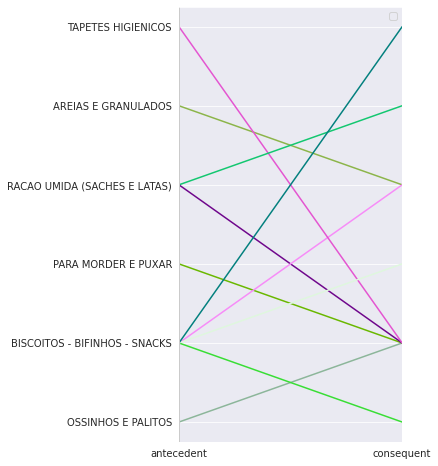

In [ ]:
# Convert rules into coordinates suitable for use in a parallel coordinates plot
coord_item = rules_to_coordinates(regra_item)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coord_item, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

In [ ]:
cvp_short_df['NIVEL 1'].unique()

array(['CAES', 'ROEDORES', 'GATOS', nan, 'AVES', 'PEIXES', 'PESSOAS'],
      dtype=object)

In [ ]:
cvp_short_df['NIVEL 2'].unique()

array(['ALIMENTOS', 'ACESSORIOS', 'FARMACIA', 'HIGIENE E BELEZA', nan,
       'AQUARIOS E ACESSORIOS', 'ANIMAL VIVO', 'CASA'], dtype=object)

In [ ]:
cachorro = (cvp_short_df[cvp_short_df['NIVEL 1']=='CAES'].groupby(['ID_VENDA', 'NIVEL 4'])['QUANTIDADE'].sum().unstack().reset_index().fillna(0).set_index('ID_VENDA'))
cachorro_encoded = cachorro.applymap(hot_encode)
cachorro_encoded.head()

NIVEL 4,ACESSORIOS FASHION,ALICATES E TESOURAS,ALMOFADAS E COLCHONETES,ANTI-INFLAMATORIOS,ANTIBIOTICOS,ANTIPULGAS E CARRAPATOS,BANHO A SECO E TALCOS,BANHO TERAPEUTICO,BISCOITOS - BIFINHOS - SNACKS,BOLSAS DE TRANSPORTE,...,TOCAS,TRATAMENTO CARDIACO,TRATAMENTO DENTARIO,TRATAMENTO DIGESTIVO,TRATAMENTO PARA OLHOS,TRATAMENTO PARA ORELHAS,TRATAMENTO PARA PELE,TRATAMENTO RESPIRATORIO,VERMIFUGOS,VITAMINAS E SUPLEMENTOS
ID_VENDA,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,1,1,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,1,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
100,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1000,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0


In [ ]:
# Building the model
freq_cachorro = apriori(cachorro_encoded, min_support = 0.015, use_colnames = True)
display(freq_cachorro.head())

# Collecting the inferred rules in a dataframe
regra_dog = association_rules(freq_cachorro, metric ="lift", min_threshold = 1)
regra_dog = regra_dog.sort_values(['confidence', 'lift'], ascending =[False, False])
display(regra_dog.head())

,support,itemsets
0,0.022742,(ANTI-INFLAMATORIOS)
1,0.029406,(ANTIBIOTICOS)
2,0.061295,(ANTIPULGAS E CARRAPATOS)
3,0.017142,(BANHO TERAPEUTICO)
4,0.155885,(BISCOITOS - BIFINHOS - SNACKS)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
1,(OSSINHOS E PALITOS),(BISCOITOS - BIFINHOS - SNACKS),0.098452,0.155885,0.029516,0.299799,1.923207,0.014169,1.205532
5,(RACAO UMIDA (SACHES E LATAS)),(BISCOITOS - BIFINHOS - SNACKS),0.099561,0.155885,0.023315,0.234176,1.502239,0.007795,1.102232
3,(PARA MORDER E PUXAR),(BISCOITOS - BIFINHOS - SNACKS),0.080294,0.155885,0.018181,0.226425,1.452513,0.005664,1.091187
0,(BISCOITOS - BIFINHOS - SNACKS),(OSSINHOS E PALITOS),0.155885,0.098452,0.029516,0.189344,1.923207,0.014169,1.112121
7,(TAPETES HIGIENICOS),(BISCOITOS - BIFINHOS - SNACKS),0.110368,0.155885,0.017740,0.160732,1.031097,0.000535,1.005776


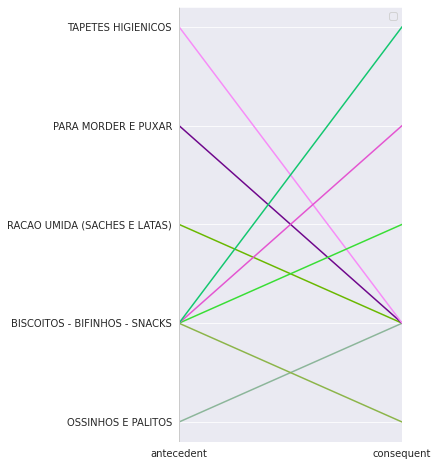

In [ ]:
# Convert rules into coordinates suitable for use in a parallel coordinates plot
coord_dog = rules_to_coordinates(regra_dog)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coord_dog, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

In [ ]:
gatos = (cvp_short_df[cvp_short_df['NIVEL 1']=='GATOS'].groupby(['ID_VENDA', 'NIVEL 4'])['QUANTIDADE'].sum().unstack().reset_index().fillna(0).set_index('ID_VENDA'))
gatos_encoded = gatos.applymap(hot_encode)
gatos_encoded.head()

NIVEL 4,ACESSORIOS FASHION,ALICATES E TESOURAS,ANTI-INFLAMATORIOS,ANTIPULGAS E CARRAPATOS,AREIAS E GRANULADOS,ARRANHADORES,BANHO A SECO E TALCOS,BISCOITOS - BIFINHOS - SNACKS,BOLSAS DE TRANSPORTE,CAIXAS DE AREIA E ACESSORIOS,...,RACAO MEDICAMENTOSA,RACAO SECA,RACAO UMIDA (SACHES E LATAS),ROUPA POS-CIRURGICA,SHAMPOOS E COSMETICOS,TOCAS,TRATAMENTO DIGESTIVO,VARINHAS - RATINHOS - BOLINHAS,VERMIFUGOS,VITAMINAS E SUPLEMENTOS
ID_VENDA,,,,,,,,,,,,,,,,,,,,,
1,0,0,0,0,0,0,0,0,0,0,...,1,0,1,0,0,0,0,0,0,0
1000,0,0,0,1,1,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
100005,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
100010,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
100012,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0


In [ ]:
# Building the model
freq_gatos = apriori(gatos_encoded, min_support = 0.015, use_colnames = True)
display(freq_gatos.head())

# Collecting the inferred rules in a dataframe
regra_cat = association_rules(freq_gatos, metric ="lift", min_threshold = 1)
regra_cat = regra_cat.sort_values(['confidence', 'lift'], ascending =[False, False])
display(regra_cat.head())

,support,itemsets
0,0.016432,(ANTIPULGAS E CARRAPATOS)
1,0.363602,(AREIAS E GRANULADOS)
2,0.017893,(ARRANHADORES)
3,0.077289,(BISCOITOS - BIFINHOS - SNACKS)
4,0.047206,(CAIXAS DE AREIA E ACESSORIOS)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
5,"(RACAO UMIDA (SACHES E LATAS), AREIAS E GRANUL...",(RACAO SECA),0.067426,0.493069,0.034346,0.509381,1.033082,0.001100,1.033247
0,(CAIXAS DE AREIA E ACESSORIOS),(AREIAS E GRANULADOS),0.047206,0.363602,0.023542,0.498710,1.371583,0.006378,1.269521
2,(BISCOITOS - BIFINHOS - SNACKS),(RACAO UMIDA (SACHES E LATAS)),0.077289,0.246751,0.029732,0.384683,1.558991,0.010661,1.224163
4,"(RACAO SECA, AREIAS E GRANULADOS)",(RACAO UMIDA (SACHES E LATAS)),0.133980,0.246751,0.034346,0.256349,1.038899,0.001286,1.012907
7,(RACAO UMIDA (SACHES E LATAS)),"(RACAO SECA, AREIAS E GRANULADOS)",0.246751,0.133980,0.034346,0.139191,1.038899,0.001286,1.006054


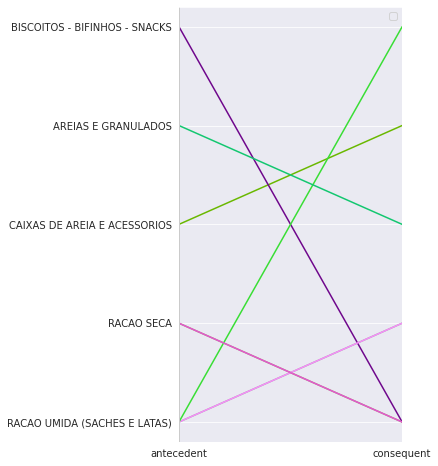

In [ ]:
# Convert rules into coordinates suitable for use in a parallel coordinates plot
coord_cat = rules_to_coordinates(regra_cat)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coord_cat, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

In [ ]:
rato = (cvp_short_df[cvp_short_df['NIVEL 1']=='ROEDORES'].groupby(['ID_VENDA', 'NIVEL 3'])['QUANTIDADE'].sum().unstack().reset_index().fillna(0).set_index('ID_VENDA'))
rato_encoded = rato.applymap(hot_encode)
rato_encoded.describe()

NIVEL 3,BRINQUEDOS,GAIOLAS E ACESSORIOS,HIGIENE E LIMPEZA,RACOES - FENOS - ALFAFAS,SUPLEMENTOS E VITAMINAS
count,26327.000000,26327.000000,26327.000000,26327.000000,26327.000000
mean,0.090971,0.240514,0.180575,0.787139,0.000684
std,0.287574,0.427403,0.384673,0.409338,0.026139
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,1.000000,0.000000
50%,0.000000,0.000000,0.000000,1.000000,0.000000
75%,0.000000,0.000000,0.000000,1.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
# Building the model
freq_rato = apriori(rato_encoded, min_support = 0.015, use_colnames = True)
display(freq_rato.head())

# Collecting the inferred rules in a dataframe
regra_mice = association_rules(freq_rato, metric ="lift", min_threshold = 1)
regra_mice = regra_mice.sort_values(['confidence', 'lift'], ascending =[False, False])
display(regra_mice.head())

,support,itemsets
0,0.090971,(BRINQUEDOS)
1,0.240514,(GAIOLAS E ACESSORIOS)
2,0.180575,(HIGIENE E LIMPEZA)
3,0.787139,(RACOES - FENOS - ALFAFAS)
4,0.033312,"(GAIOLAS E ACESSORIOS, BRINQUEDOS)"


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
5,"(RACOES - FENOS - ALFAFAS, BRINQUEDOS)",(GAIOLAS E ACESSORIOS),0.049911,0.240514,0.023854,0.477930,1.987123,0.011850,1.454760
1,(BRINQUEDOS),(GAIOLAS E ACESSORIOS),0.090971,0.240514,0.033312,0.366180,1.522490,0.011432,1.198268
9,"(RACOES - FENOS - ALFAFAS, HIGIENE E LIMPEZA)",(GAIOLAS E ACESSORIOS),0.093136,0.240514,0.032704,0.351142,1.459967,0.010304,1.170497
7,(BRINQUEDOS),"(RACOES - FENOS - ALFAFAS, GAIOLAS E ACESSORIOS)",0.090971,0.133741,0.023854,0.262213,1.960602,0.011687,1.174131
8,"(RACOES - FENOS - ALFAFAS, GAIOLAS E ACESSORIOS)",(HIGIENE E LIMPEZA),0.133741,0.180575,0.032704,0.244533,1.354189,0.008554,1.084660


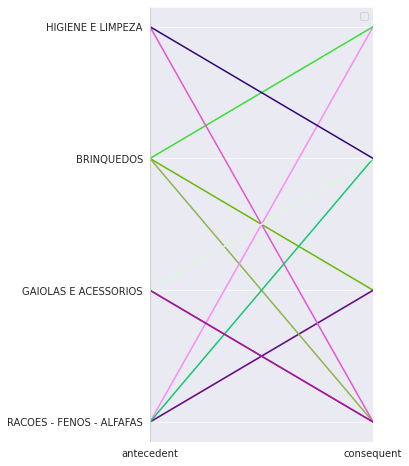

In [ ]:
# Convert rules into coordinates suitable for use in a parallel coordinates plot
coord_mice = rules_to_coordinates(regra_mice)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coord_mice, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

In [ ]:
pomba = (cvp_short_df[cvp_short_df['NIVEL 1']=='AVES'].groupby(['ID_VENDA', 'NIVEL 3'])['QUANTIDADE'].sum().unstack().reset_index().fillna(0).set_index('ID_VENDA'))
pomba_encoded = pomba.applymap(hot_encode)
pomba_encoded.head()

NIVEL 3,BRINQUEDOS,GAIOLAS E ACESSORIOS,HIGIENE E LIMPEZA,RACOES,SUPLEMENTOS E VITAMINAS
ID_VENDA,,,,,
0,0,0,0,1,0
100004,0,0,0,1,0
100029,0,0,0,1,0
100040,1,1,0,1,0
100084,0,0,0,1,0


In [ ]:
# Building the model
freq_pomba = apriori(pomba_encoded, min_support = 0.015, use_colnames = True)
display(freq_pomba.head())

# Collecting the inferred rules in a dataframe
regra_bird = association_rules(freq_pomba, metric ="lift", min_threshold = 1)
regra_bird = regra_bird.sort_values(['confidence', 'lift'], ascending =[False, False])
display(regra_mice.head())

,support,itemsets
0,0.064108,(BRINQUEDOS)
1,0.332176,(GAIOLAS E ACESSORIOS)
2,0.777328,(RACOES)
3,0.053980,(SUPLEMENTOS E VITAMINAS)
4,0.029546,"(GAIOLAS E ACESSORIOS, BRINQUEDOS)"


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,antecedent,consequent,rule
5,"(RACOES - FENOS - ALFAFAS, BRINQUEDOS)",(GAIOLAS E ACESSORIOS),0.049911,0.240514,0.023854,0.477930,1.987123,0.011850,1.454760,RACOES - FENOS - ALFAFAS,GAIOLAS E ACESSORIOS,5
1,(BRINQUEDOS),(GAIOLAS E ACESSORIOS),0.090971,0.240514,0.033312,0.366180,1.522490,0.011432,1.198268,BRINQUEDOS,GAIOLAS E ACESSORIOS,1
9,"(RACOES - FENOS - ALFAFAS, HIGIENE E LIMPEZA)",(GAIOLAS E ACESSORIOS),0.093136,0.240514,0.032704,0.351142,1.459967,0.010304,1.170497,RACOES - FENOS - ALFAFAS,GAIOLAS E ACESSORIOS,9
7,(BRINQUEDOS),"(RACOES - FENOS - ALFAFAS, GAIOLAS E ACESSORIOS)",0.090971,0.133741,0.023854,0.262213,1.960602,0.011687,1.174131,BRINQUEDOS,RACOES - FENOS - ALFAFAS,7
8,"(RACOES - FENOS - ALFAFAS, GAIOLAS E ACESSORIOS)",(HIGIENE E LIMPEZA),0.133741,0.180575,0.032704,0.244533,1.354189,0.008554,1.084660,RACOES - FENOS - ALFAFAS,HIGIENE E LIMPEZA,8


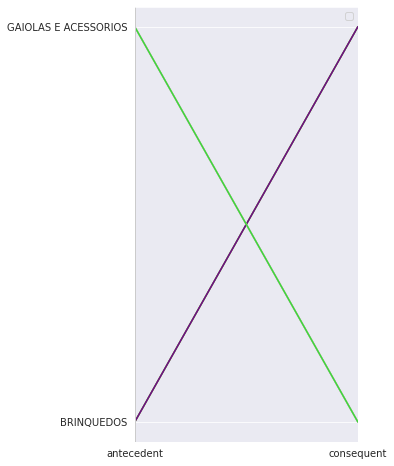

In [ ]:
# Convert rules into coordinates suitable for use in a parallel coordinates plot
coord_bird = rules_to_coordinates(regra_bird)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coord_bird, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

In [ ]:
cvp_short_df['NIVEL 1'].unique()

array(['CAES', 'ROEDORES', 'GATOS', nan, 'AVES', 'PEIXES', 'PESSOAS'],
      dtype=object)

In [ ]:
peixe = (cvp_short_df[cvp_short_df['NIVEL 1']=='PEIXES'].groupby(['ID_VENDA', 'NIVEL 3'])['QUANTIDADE'].sum().unstack().reset_index().fillna(0).set_index('ID_VENDA'))
peixe_encoded = peixe.applymap(hot_encode)
peixe_encoded.head()

NIVEL 3,AQUARIOS,BOMBAS E CONDICIONADORES,DECORACAO E ILUMINACAO,RACOES,SUPLEMENTOS E VITAMINAS
ID_VENDA,,,,,
100076,0,0,0,1,0
100107,0,0,0,1,0
100147,0,0,0,1,0
100222,1,0,0,0,0
100295,0,1,0,0,0


In [ ]:
# Building the model
freq_peixe = apriori(peixe_encoded, min_support = 0.015, use_colnames = True)
display(freq_peixe.head())

# Collecting the inferred rules in a dataframe
regra_fish = association_rules(freq_peixe, metric ="lift", min_threshold = 1)
regra_fish = regra_fish.sort_values(['confidence', 'lift'], ascending =[False, False])
display(regra_fish.head())

,support,itemsets
0,0.120620,(AQUARIOS)
1,0.397165,(BOMBAS E CONDICIONADORES)
2,0.210538,(DECORACAO E ILUMINACAO)
3,0.639636,(RACOES)
4,0.015833,(SUPLEMENTOS E VITAMINAS)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
13,"(BOMBAS E CONDICIONADORES, AQUARIOS)",(RACOES),0.069163,0.639636,0.056753,0.820572,1.282873,0.012514,2.008406
31,"(AQUARIOS, RACOES, DECORACAO E ILUMINACAO)",(BOMBAS E CONDICIONADORES),0.032683,0.397165,0.026371,0.806874,2.031584,0.013390,3.121459
29,"(BOMBAS E CONDICIONADORES, AQUARIOS, DECORACAO...",(RACOES),0.032950,0.639636,0.026371,0.800325,1.251218,0.005295,1.804748
14,"(RACOES, AQUARIOS)",(BOMBAS E CONDICIONADORES),0.080984,0.397165,0.056753,0.700793,1.764487,0.024589,2.014773
8,"(AQUARIOS, DECORACAO E ILUMINACAO)",(BOMBAS E CONDICIONADORES),0.047071,0.397165,0.032950,0.700000,1.762492,0.014255,2.009450


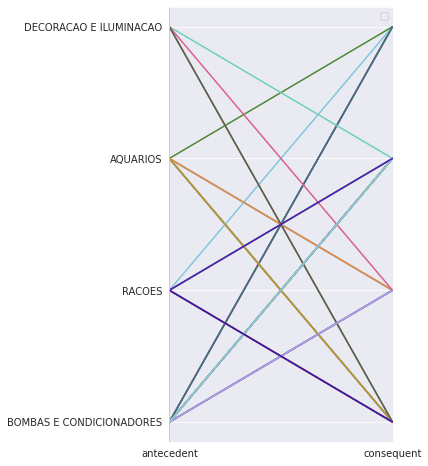

In [ ]:
# Convert rules into coordinates suitable for use in a parallel coordinates plot
coord_fish = rules_to_coordinates(regra_fish)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coord_fish, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

In [ ]:
display(setor.describe())
display(tipo_prod.describe())
display(cachorro.describe())
display(gatos.describe())
display(rato.describe())
display(pomba.describe())

NIVEL 3,ACESSORIOS MEDICOS,ACESSORIOS PARA ALIMENTACAO,ADESTRAMENTO E COMPORTAMENTO,AQUARIOS,BOMBAS E CONDICIONADORES,BRINQUEDOS,CAMINHAS E CASINHAS,COLEIRAS E PEITORAIS,DECORACAO,DECORACAO E ILUMINACAO,...,PORTOES - GRADES - ESCADAS,PULGAS - CARRAPATOS - VERMES,RACOES,RACOES - FENOS - ALFAFAS,ROUPINHAS E ACESSORIOS,SALGADOS,SUPLEMENTOS E VITAMINAS,TRANSPORTE E VIAGEM,UTENSILIOS PARA BANHO,VITAMINAS E SUPLEMENTOS
count,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,...,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000,683485.000000
mean,0.009147,0.080686,0.028005,0.003552,0.017168,0.191205,0.020752,0.068265,0.001530,0.011911,...,0.009207,0.098406,1.159642,0.046358,0.023168,0.000136,0.003498,0.014150,0.106770,0.058759
std,0.102242,0.385704,0.194735,0.064703,0.202093,0.608222,0.158181,0.328060,0.045843,0.199929,...,0.114042,0.396452,2.571053,0.304402,0.224866,0.012971,0.072823,0.128319,0.440472,0.319823
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,7.000000,24.000000,23.000000,6.000000,20.000000,18.000000,8.000000,15.000000,5.000000,16.000000,...,10.000000,18.000000,123.000000,16.000000,35.000000,3.000000,10.000000,6.000000,74.000000,56.000000


NIVEL 4,ACESSORIOS FASHION,ALICATES E TESOURAS,ALMOFADAS E COLCHONETES,ANTI-INFLAMATORIOS,ANTIBIOTICOS,ANTIPULGAS E CARRAPATOS,AREIAS E GRANULADOS,ARRANHADORES,BANHO A SECO E TALCOS,BANHO TERAPEUTICO,...,TRATAMENTO CARDIACO,TRATAMENTO DENTARIO,TRATAMENTO DIGESTIVO,TRATAMENTO PARA OLHOS,TRATAMENTO PARA ORELHAS,TRATAMENTO PARA PELE,TRATAMENTO RESPIRATORIO,VARINHAS - RATINHOS - BOLINHAS,VERMIFUGOS,VITAMINAS E SUPLEMENTOS
count,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,...,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000,634656.000000
mean,0.011121,0.004492,0.009175,0.022212,0.030762,0.067999,0.141089,0.004374,0.011384,0.015319,...,0.003671,0.004686,0.012142,0.005672,0.016541,0.024131,0.000660,0.018690,0.037978,0.063280
std,0.177224,0.070921,0.103416,0.166243,0.218711,0.314293,0.621275,0.069413,0.113992,0.130239,...,0.066082,0.071934,0.144340,0.080762,0.143365,0.173168,0.025869,0.165989,0.228393,0.331467
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,29.000000,6.000000,7.000000,6.000000,17.000000,18.000000,32.000000,4.000000,7.000000,5.000000,...,5.000000,4.000000,19.000000,6.000000,5.000000,9.000000,2.000000,9.000000,11.000000,56.000000


NIVEL 4,ACESSORIOS FASHION,ALICATES E TESOURAS,ALMOFADAS E COLCHONETES,ANTI-INFLAMATORIOS,ANTIBIOTICOS,ANTIPULGAS E CARRAPATOS,BANHO A SECO E TALCOS,BANHO TERAPEUTICO,BISCOITOS - BIFINHOS - SNACKS,BOLSAS DE TRANSPORTE,...,TOCAS,TRATAMENTO CARDIACO,TRATAMENTO DENTARIO,TRATAMENTO DIGESTIVO,TRATAMENTO PARA OLHOS,TRATAMENTO PARA ORELHAS,TRATAMENTO PARA PELE,TRATAMENTO RESPIRATORIO,VERMIFUGOS,VITAMINAS E SUPLEMENTOS
count,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,...,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000,535408.000000
mean,0.013173,0.004288,0.010876,0.025661,0.036464,0.075173,0.011302,0.018158,0.245811,0.004247,...,0.000867,0.004352,0.005555,0.014382,0.006724,0.019607,0.028604,0.000783,0.042696,0.071667
std,0.192849,0.069392,0.112512,0.178381,0.237684,0.328072,0.112503,0.141615,0.752516,0.067733,...,0.029867,0.071926,0.078288,0.156988,0.087890,0.155895,0.188196,0.028163,0.239636,0.353113
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,29.000000,3.000000,7.000000,6.000000,17.000000,18.000000,7.000000,5.000000,45.000000,3.000000,...,2.000000,5.000000,4.000000,19.000000,6.000000,5.000000,9.000000,2.000000,11.000000,56.000000


NIVEL 4,ACESSORIOS FASHION,ALICATES E TESOURAS,ANTI-INFLAMATORIOS,ANTIPULGAS E CARRAPATOS,AREIAS E GRANULADOS,ARRANHADORES,BANHO A SECO E TALCOS,BISCOITOS - BIFINHOS - SNACKS,BOLSAS DE TRANSPORTE,CAIXAS DE AREIA E ACESSORIOS,...,RACAO MEDICAMENTOSA,RACAO SECA,RACAO UMIDA (SACHES E LATAS),ROUPA POS-CIRURGICA,SHAMPOOS E COSMETICOS,TOCAS,TRATAMENTO DIGESTIVO,VARINHAS - RATINHOS - BOLINHAS,VERMIFUGOS,VITAMINAS E SUPLEMENTOS
count,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,...,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000,147821.000000
mean,0.000034,0.003755,0.002422,0.019672,0.605753,0.018779,0.007942,0.140975,0.000007,0.055418,...,0.081362,0.584403,1.286367,0.004201,0.003707,0.004749,0.000041,0.080246,0.008409,0.012109
std,0.005816,0.061819,0.049700,0.166721,1.172908,0.142884,0.095589,0.658095,0.002601,0.272791,...,0.596422,0.717272,3.822008,0.069226,0.062746,0.072579,0.008225,0.336682,0.115459,0.123712
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,3.000000,2.000000,9.000000,32.000000,4.000000,5.000000,35.000000,1.000000,16.000000,...,62.000000,20.000000,118.000000,3.000000,2.000000,4.000000,2.000000,9.000000,7.000000,7.000000


NIVEL 3,BRINQUEDOS,GAIOLAS E ACESSORIOS,HIGIENE E LIMPEZA,RACOES - FENOS - ALFAFAS,SUPLEMENTOS E VITAMINAS
count,26327.000000,26327.000000,26327.000000,26327.000000,26327.000000
mean,0.105557,0.348046,0.228207,1.203517,0.000684
std,0.366784,0.736701,0.557113,1.006466,0.026139
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,1.000000,0.000000
50%,0.000000,0.000000,0.000000,1.000000,0.000000
75%,0.000000,0.000000,0.000000,2.000000,0.000000
max,9.000000,12.000000,11.000000,16.000000,1.000000


NIVEL 3,BRINQUEDOS,GAIOLAS E ACESSORIOS,HIGIENE E LIMPEZA,RACOES,SUPLEMENTOS E VITAMINAS
count,31104.000000,31104.000000,31104.000000,31104.000000,31104.000000
mean,0.078414,0.534529,0.007330,1.384516,0.065811
std,0.339917,1.012587,0.117625,1.417882,0.314392
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,1.000000,0.000000
50%,0.000000,0.000000,0.000000,1.000000,0.000000
75%,0.000000,1.000000,0.000000,2.000000,0.000000
max,15.000000,20.000000,8.000000,40.000000,10.000000
